# Mamba

## Mamba理论

# 一文通透想颠覆Transformer的Mamba：从SSM、HiPPO、S4到Mamba(被誉为Mamba最佳解读)


### 前言

不知读者发现没有，本文标题的信息含量很大，比如

1.  出来了一个新的序列模型：Mamba，其基于SSM或S4发展为S6(_S4 models with a **selection** mechanism and computed with a **scan**_)，其对应的论文为《[Mamba: Linear-Time Sequence Modeling with Selective State Spaces](https://arxiv.org/abs/2312.00752 "Mamba: Linear-Time Sequence Modeling with Selective State Spaces")》
2.  该Mamba模型的提出者为Albert Gu、Tri Dao，前者现在是CMU助理教授，多年来一直推动SSM架构发展，曾在DeepMind 工作，后者则为鼎鼎大名的Flash Attention一作  
    换言之，除了论文中展示的效果确实不错之外，由于提出者的背景不一般，所以关注的人比较多
3.  Transformer统治各大领域近7年了，7年来，挑战Transformer的模型其实不少 (_比如linear attention, gated convolution and recurrent models, and SSMs_)，该模型能否真正颠覆Transformer的霸权呢？  
    对此，我们可以细究其原理细节，看看其创新到底是否靠谱、力度是否大

加之有一大模型[项目开发](https://so.csdn.net/so/search?q=%E9%A1%B9%E7%9B%AE%E5%BC%80%E5%8F%91&spm=1001.2101.3001.7020)营的朋友问道，可否在论文100课上解读下Mamba这篇论文，于此，便有了此文，且具备3个特点

1.  **清晰易懂：也为「不需要天天看paper的朋友」而写**  
    在ChatGPT诞生后的一年来，以大模型为代表的技术发展特别快，经常一个月会出来很多新的技术、模型  
    而不一定非得是每天在实验室扎根于科研的人 才有资格去追踪前沿技术发展，还有一大帮可能是出于对前沿技术的了解、兴趣、热爱、应用而想追踪，可这帮朋友平时或因工作或事太多而不一定对每个新技术、新模型都去看一遍论文，即不可能天天看paper  
      
    那咋办呢？他们可能通过一些比如公众号之类的文章去了解，但有的公号文章写的不错，有的则写的不够清晰易懂甚至漏洞百出，会因此让读到这种文章的朋友对新技术、新模型产生畏难心理甚至被误导  
      
    故，我和我司来了，为帮助更多朋友更好、更快、更细致的了解大模型相关技术及其实践，我个人算是笔耕不辍(_我在23年一年史无前例的写了30篇，比如这是其中一部分：___[大模型与ChatGPT系列：原理、论文、代码、应用](https://blog.csdn.net/v_july_v/category_12306170.html "大模型与ChatGPT系列：原理、论文、代码、应用")____)、团队和我算讲课不停
2.  **中英对比：部分关键的阐述中英文对照学习**  
    考虑到这些新技术、新模型刚推出的时候，论文还是相对最严谨的参考，所以本文会延续前几篇文章的风格：对于一些关键的阐述会把原英文的表述用斜体且淡色的黑体表示，毕竟有的描述与其翻译相比，用原英文阐述更精准
3.  **足够细致：从SSM、HiPPO、S4起步，逐步推导到Mamba**  
    目前介绍mamba模型的文章，少部分写得很不错，大部分不是这个细节没深入，便是那个细节没深入，考虑到如果很多关键细节没有介绍的话，那没法一步一步、循序渐进的彻底理解mamba模型(_比如如果不理解SSM和S4则无法理解mamba模型，故本文会_**_从HiPPO、SSM、S4起步，逐步推导到mamba_**)  
    因此，本文会尽可能兼顾所有必须写清楚的细节，尽可能一文通透mamba模型  
      
    且后续又做了三轮重大更新(_当然，再后续又做了一系列更新，详见本文文末_)：  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  1) 24年3.2-3.11，这10来天做了第一轮大规模修订  
    比如把前置知识特别是ssm/S4介绍的更加细致(_过程中的核心参考之一是：**A Visual Guide to Mamba and State Space Models**，有些图来自该文，有些内容或翻译 或改自此文_)，以让文科生都能一眼看明白  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  2) 24年3.23-3.27，这几天做了第二轮大规模修订  
    比如把此节「3.1.1 选择性状态空间模型：从S4到S6」的内容做了全面细致的补充  
    特别是把A B C三个矩阵分别在S4、mamba中各自所对应的背后含义、维度表示、维度变化一针见血的解释清楚  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  3) 24年5.7，针对SSM和mamba分别在训练、推理过程中的参数到底变还是不变做重点补充说明，详见于下文的2.3节

总之，看本文之前，你可能看到的很多关于mamba的文章都不知所云，但看了本文之后，你再看那些文章你会有一种“他如果怎样怎样写，会更加清晰易懂”的感觉，毕竟**“好懂的文章”只有一个标准：就是能一直不烧脑的读下去而不卡壳**

### 第一部分 SSM的起源：从Transformer复杂度、RNN到SSM

#### 1.1 Transformer的二次复杂度

通过之前本博客内的另一篇文章《[通透理解FlashAttention(含其2代和第3代)：全面降低显存读写、加快计算速度](https://blog.csdn.net/v_JULY_v/article/details/133619540 "通透理解FlashAttention(含其2代和第3代)：全面降低显存读写、加快计算速度")》，可知

> 简单理解的话，计算复杂度和序列长度的平方![N^2](https://latex.csdn.net/eq?N%5E2)成正比，可以看一个小例子，比如两个相乘的矩阵大小分别为(![N \times d](https://latex.csdn.net/eq?N%20%5Ctimes%20d)) 和(![d \times N](https://latex.csdn.net/eq?d%20%5Ctimes%20N))，[矩阵乘法](https://so.csdn.net/so/search?q=%E7%9F%A9%E9%98%B5%E4%B9%98%E6%B3%95&spm=1001.2101.3001.7020)的一种计算方式是使用第一个矩阵的每一行与第二个矩阵的每一列做​点乘​
> 
> ![](https://i-blog.csdnimg.cn/blog_migrate/5923667019cb682524e22b72827ac36d.png)
> 
> 因为我们需要拿第一个矩阵的每一行去与第二个矩阵的每一列做点乘，所以总共就需要 ![N^2](https://latex.csdn.net/eq?N%5E2) 次点乘。而每次点乘又需要 ![d](https://latex.csdn.net/eq?d) 次乘法，所以总复杂度就为 ![\mathrm O(N^2d)](https://latex.csdn.net/eq?%5Cmathrm%20O%28N%5E2d%29)
> 
> * * *
> 
> 精确理解的话，当输入批次大小为 ![b](https://latex.csdn.net/eq?b)​ ，序列长度为 ![N](https://latex.csdn.net/eq?N)​ 时，  
> ![l](https://latex.csdn.net/eq?l)​ 层transformer模型的计算量为 ![l *\left(24 b N d^{2}+4 b N^{2} d\right)](https://latex.csdn.net/eq?l%20*%5Cleft%2824%20b%20N%20d%5E%7B2%7D&plus;4%20b%20N%5E%7B2%7D%20d%5Cright%29)​，![d](https://latex.csdn.net/eq?d)​则代表词向量的维度或者隐藏层的维度(隐藏层维度通常等于词向量维度)
> 
> 但这个结果是怎么一步一步计算得到的呢？请看[原文](https://blog.csdn.net/v_JULY_v/article/details/133619540 "原文")

正因为现有的ChatGPT等大模型处理长文本算力消耗巨大，背后原因是Transformer架构中注意力机制的二次复杂度

1.  一方面，有了针对注意力机制的各种所谓魔改，甚至也有S4、FlashAttention及其二代等
2.  二方面，S4、FlashAttention等作者提出了新的序列模型：Mamba，在很多语言任务上击败/匹配Transformer性能，具有线性复杂度和5倍推理吞吐量，下文详述

#### 1.2 RNN：隐藏状态![h_t](https://latex.csdn.net/eq?h_t)​基于当前输入![x_t](https://latex.csdn.net/eq?x_t)和前一个时刻的隐藏状态![h_{t-1}](https://latex.csdn.net/eq?h_%7Bt-1%7D)​计算

关于什么是RNN，我之前博客内的这篇文章《[如何从RNN起步，一步一步通俗理解LSTM](https://blog.csdn.net/v_JULY_v/article/details/89894058 "如何从RNN起步，一步一步通俗理解LSTM")》中做了详细介绍，每一个时刻的隐藏状态![h_t](https://latex.csdn.net/eq?h_t)​都是基于当前的输入![x_t](https://latex.csdn.net/eq?x_t)和前一个时刻的隐藏状态![h_{t-1}](https://latex.csdn.net/eq?h_%7Bt-1%7D)​计算得到的，比如泛化到任一时刻，便是![h_{t}=tanh \left(W h_{t-1}+U x_{t}\right)](https://latex.csdn.net/eq?h_%7Bt%7D%3Dtanh%20%5Cleft%28W%20h_%7Bt-1%7D&plus;U%20x_%7Bt%7D%5Cright%29)

![](https://i-blog.csdnimg.cn/blog_migrate/9223e4f28da9ddf5d3b2735c77bdb744.png)

总之，RNN在序列中的每个时间步需要两个输入，即时间步![t](https://latex.csdn.net/eq?t)的输入![x_t](https://latex.csdn.net/eq?x_t)和前一个时间步![t-1](https://latex.csdn.net/eq?t-1)的隐藏状态![h_{t-1}](https://latex.csdn.net/eq?h_%7Bt-1%7D)(_a hidden state of the previous time step_)，以生成![t](https://latex.csdn.net/eq?t)时的隐藏状态![h_t](https://latex.csdn.net/eq?h_t)，最终预测输出![y_t](https://latex.csdn.net/eq?y_t)(_to generate the next hidden state and predict the output_)

![](https://i-blog.csdnimg.cn/blog_migrate/176d861318c4b4571839ff740464b597.png)

> 这一点值得好好体会：**先根据输入![x_t](https://latex.csdn.net/eq?x_t)和前一时刻的隐藏状态![h_{t-1}](https://latex.csdn.net/eq?h_%7Bt-1%7D)计算出最新的隐藏状态![h_t](https://latex.csdn.net/eq?h_t)，便可以根据最新的隐藏状态![h_t](https://latex.csdn.net/eq?h_t)预测出![y_t](https://latex.csdn.net/eq?y_t)了**
> 
> * * *
> 
> 至于为何要先介绍RNN呢，很快你就会明白了(_RNN和SSM是一个本质_)
> 
> ![](https://i-blog.csdnimg.cn/blog_migrate/42e56bad747fb25fb7227a6fe9a37de3.png)

RNN主要存在两个问题

-   第一个问题在于，虽然每个隐藏状态都是所有先前隐藏状态的聚合，然随着时间的推移，RNN 往往会忘记某一部分信息，比如下图最后一个隐藏状态在生成名称“ Maarten”时不再包含有关单词“Hello”的信息(_说白了，就是如[此文](https://blog.csdn.net/v_JULY_v/article/details/89894058 "此文")所说的，在实践中，![h_t](https://latex.csdn.net/eq?h_t)一般只包含前面若干步而非之前所有步的隐藏状态_)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/01a0abd7c37c66934293e71322268ea1.png)
    
-   第二个问题在于，RNN没法并行训练，相当于推理快但训练慢  
    正在读本文的你，可曾想过为何RNN没法并行训练？可能很多读者立马反应出来了：在于其每个时间步的输出依赖于前一个时间步的输出  
    另，顺带说下，因为RNN这个结构，也导致其没法写成卷积形式(_因为RNN多了一个非线性的转换函数，比如tanh_)

#### 1.3 什么是状态空间与SSM

简言之，SSM源于卡尔曼滤波器\[_33-A new approach to linear filtering and prediction problems，关于卡尔曼滤波详见此文《_[通俗理解卡尔曼滤波（无人驾驶感知融合的经典算法）](https://blog.csdn.net/v_JULY_v/article/details/120344668 "通俗理解卡尔曼滤波（无人驾驶感知融合的经典算法）")_》，当然了，你不看卡尔曼滤波也不影响对本文的理解_\]，SSM 可以被视为线性时不变(LTI)系统

但要真正通俗易懂的讲清楚SSM的一切 也并不是一件很轻松的事，好在如本文开头所述，Maarten Grootendorst写了一篇《A Visual Guide to Mamba and State Space Models》，很通俗，包括本部分中的不少图来自该文，不少内容翻译自此文，至于原英文中有些表述不准确的地方，我则都已修正

话休絮烦，接下来，咱们便通过一个个图示、一个个示例来透彻理解SSM

##### 1.3.1 什么是状态空间

想象一下我们正在穿过一个迷宫，图中每个小框代表迷宫中的一个位置，并附有某个隐式的信息，例如你距离出口有多远

![](https://i-blog.csdnimg.cn/blog_migrate/6c3bb2af0da547aeafd763f65c63789e.png)

而上述迷宫可以简化建模为一个“_状态空间表示state space representation_”，每一个小框显示

-   你当前所在的位置(当前状态current state)
-   下一步可以去哪里(未来可能的状态possible future states)
-   以及哪些变化会将你带到下一个状态(向右或向左)

而描述状态的变量(在我们的示例中为 X 和 Y 坐标以及到出口的距离)可以表示为“_状态向量state vectors_”

![](https://i-blog.csdnimg.cn/blog_migrate/489b064aeeaf7fcf7ec06f58c1303e9a.png)

##### 1.3.2 什么是状态空间模型SSM——RNN本质就是一个SSM

SSM 是用于描述这些状态表示并根据某些输入预测其下一个状态可能是什么的模型

一般SSMs包括以下组成

-   映射输入序列x(t)，比如在迷宫中向左和向下移动
-   到潜在状态表示h(t)，比如距离出口距离和 x/y 坐标
-   并导出预测输出序列y(t)，比如再次向左移动以更快到达出口

然而，它不使用离散序列(如向左移动一次)，而是将连续序列作为输入并预测输出序列

![](https://i-blog.csdnimg.cn/blog_migrate/0e59d72e6d6ffbf416e2d6350ffe2615.png)

SSM 假设动态系统(例如在 3D 空间中移动的物体)可以通过两个方程从其在时间![t](https://latex.csdn.net/eq?t) 时的状态进行预测「 _注，如本文读者Enzo和叶启来迁移所说，“这里就是导数，是SSM 一阶微分方程 中的导数，这里还是连续型，不是离散型，毕竟只有在离散系统中才是t和t-1”_ 」

![](https://i-blog.csdnimg.cn/blog_migrate/3b74e60c40a35415ccb04391946a7f62.png)

然后，请你再细品一下

1.  上面的第一个方程是不是和RNN循环结构：![h_{t}=tanh \left(W h_{t-1}+U x_{t}\right)](https://latex.csdn.net/eq?h_%7Bt%7D%3Dtanh%20%5Cleft%28W%20h_%7Bt-1%7D&plus;U%20x_%7Bt%7D%5Cright%29)非常类似？——通过上一个隐藏状态和当前输入综合得到当前的隐藏状态，只是两个权重W、U换成了![A](https://latex.csdn.net/eq?A)、![B](https://latex.csdn.net/eq?B)两个系数，且去掉了非线性的激活函数tanh
2.  但系数![A](https://latex.csdn.net/eq?A)代表着什么，这点其实非常关键，然我看过的几乎所有讲解SSM/S4/mamba的文章都没有一针见血的指出来，其实A就是存储着之前所有历史信息的浓缩精华(_可以通过一系列系数组成的矩阵表示之_)，以基于A更新下一个时刻的空间状态hidden state

总之，通过求解这些方程，可以根据观察到的数据：输入序列和先前状态，去预测系统的未来状态

##### 1.3.3 SSM的两个方程：状态方程与输出方程

总之，SSM的关键是找到：状态表示(state representation)—— ![h(t)](https://latex.csdn.net/eq?h%28t%29)_**，**_以便结合「其与输入序列」预测输出序列

![](https://i-blog.csdnimg.cn/blog_migrate/9437604b494c53d4e7c1b057c5b5135b.png)

而这两个方程也是状态空间模型的核心( _注意，_ _一方面_ _，_ _A、B、C、D这4个矩阵是参数，是可以学习到的，二方面，学习好之后，在SSM中，矩阵A、B、C、D便固定不变了——即便是在不同的输入之下，但到了后续的改进版本mamba中则这4个矩阵可以随着输入不同而可变_)

-   第一个方程：状态方程，矩阵![B](https://latex.csdn.net/eq?B)与输入![x(t)](https://latex.csdn.net/eq?x%28t%29)相乘之后，再加上矩阵![A](https://latex.csdn.net/eq?A)与**前一个状态![h(t)](https://latex.csdn.net/eq?h%28t%29)**相乘的结果
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/f714f8ff6828b57051b10ad4b4363e17.png)
    
    换言之，![B](https://latex.csdn.net/eq?B)矩阵影响输入![x(t)](https://latex.csdn.net/eq?x%28t%29)，![A](https://latex.csdn.net/eq?A)矩阵影响前一个状态![h(t)](https://latex.csdn.net/eq?h%28t%29)  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  ![h(t)](https://latex.csdn.net/eq?h%28t%29)指的是任何给定时间![t](https://latex.csdn.net/eq?t)的潜在状态表示(_latent state representation_)  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  ![x(t)](https://latex.csdn.net/eq?x%28t%29)指的是某个输入  
    「_当然，也可以表示成这样：__![h(t) = Ah(t-1) + Bx(t)](https://latex.csdn.net/eq?h%28t%29%20%3D%20Ah%28t-1%29%20&plus;%20Bx%28t%29)_」
-   第二个方程：输出方程，描述了状态如何转换为输出(通过_矩阵 ![C](https://latex.csdn.net/eq?C))，_以及输入如何影响输出(通过_矩阵 ![D](https://latex.csdn.net/eq?D))_
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/cbbcc06a387cf200eee36c3bb0186fe6.png)
    

##### 1.3.4 建立对SSM中两个核心方程的统一视角

最终，我们可以通过下图统一这两个方程

![](https://i-blog.csdnimg.cn/blog_migrate/1a998dc00f06e9e1b302c041d33d497d.png)

为了进一步加深对该图的理解，我们一步一步拆解下

1.  假设我们有一些输入信号![x(t)](https://latex.csdn.net/eq?x%28t%29)，该信号首先乘以_矩阵 ![B](https://latex.csdn.net/eq?B)_ 
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/3a5756d4feb7e35689542a7d9a54d8ba.png)
    
2.  上面第一步的结果，加上：上一个状态与矩阵![A](https://latex.csdn.net/eq?A)相乘(_矩阵![A](https://latex.csdn.net/eq?A)__描述了所有内部状态如何连接_)的结果，用来更新状态state
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/8795657fdd23aecad0c8283746c3e7fc.png)
    
3.  然后，使用矩阵_![C](https://latex.csdn.net/eq?C)_来将状态转换为输出
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/e86f3b7388ed710929d660d0a9bec1b8.png)
    
4.  最后，再利用矩阵![D](https://latex.csdn.net/eq?D)提供从输入到输出的直接信号，这通常也称为_跳跃连接skip-connection_
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/b331e2c0c8a234cd93196755bdef93f0.png)
    
5.  由于矩阵![D](https://latex.csdn.net/eq?D)类似于跳跃连接，因此在没有跳跃连接的情况下，SSM 通常被视为如下
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/b3fffed417caa755ed6b506eb12ebd84.png)
    

回到我们的简化视角，现在可以关注只矩阵![A,B,C](https://latex.csdn.net/eq?A%2CB%2CC)构建的SSM核心

![](https://i-blog.csdnimg.cn/blog_migrate/e3b32579360aa65d31e8f05a774b03e0.png)

总之，这两个方程共同旨在根据观测数据预测系统的状态，且考虑到输入一般都是连续的，因此SSM的主要表示是：连续时间表示( _continuous-time representation_ )

![](https://i-blog.csdnimg.cn/blog_migrate/f35348495fe1790d40ed594ce11773d6.png)

### 第二部分 从SSM到S4、S4D的升级之路

#### 2.1 SSM到S4D的6步升级：离散化SSM、循环表示、卷积表示、基于HiPPO处理长序列、S4、S4D

##### 2.1.1 离散数据的连续化：基于零阶保持技术做连续化并采样

由于除了连续的输入之外，还会通常碰到离散的输入(如文本序列)「_当然了，就算SSM在离散数据上训练，它仍能学习到底层蕴含的连续信息，因为在SSM眼里，sequence不过是连续信号signal的采样，或者说连续的信号模型是离散的序列模型的概括_」

![](https://i-blog.csdnimg.cn/blog_migrate/b5a929a6afb2e51c9959271488db6e58.png)

那模型如何处理离散化数据呢？答案是可以利用_零阶保持技术(Zero-order hold technique)_

![](https://i-blog.csdnimg.cn/blog_migrate/9b5b7e0a489a361d49206b3d075e70d4.png)

1.  首先，每次收到离散信号时，我们都会保留其值，直到收到新的离散信号，如此操作导致的结果就是**创建了 SSM 可以使用的连续信号**
2.  保持该值的时间由一个新的可学习参数表示，称为_步长(siz)——![\Delta](https://latex.csdn.net/eq?%5CDelta)_ ，它代表输入的阶段性保持(resolution)
3.  有了连续的输入信号后，便可以生成连续的输出，并且仅根据输入的时间步长对值进行采样
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/0e7c866d0ef55857ca8d5fc12608e97d.png)
    

这些采样值就是我们的离散输出，且可以针对A、B按如下方式做零阶保持(_做了零阶保持的在对应变量上面加了个横杠_)

![](https://i-blog.csdnimg.cn/blog_migrate/5cf7c68f0312853c4dae2b81b73a0702.png)

最终使我们能够从连续 SSM 转变为离散SSM，使得不再是_函数到函数_![x(t) \rightarrow y(t)](https://latex.csdn.net/eq?x%28t%29%20%5Crightarrow%20y%28t%29)，而是_序列到序列_![x_{k} \rightarrow y_{k}](https://latex.csdn.net/eq?x_%7Bk%7D%20%5Crightarrow%20y_%7Bk%7D)

所以你看到，矩阵![\overline{\mathbf{A}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BA%7D%7D)和![\overline{\mathbf{B}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BB%7D%7D)现在表示模型的离散参数，且这里使用![k](https://latex.csdn.net/eq?k)，而不是![t](https://latex.csdn.net/eq?t) 来表示离散的时间步长

![](https://i-blog.csdnimg.cn/blog_migrate/c7cd6784f004bf9a87dc948b0e5b964a.png)

注意：我们在保存时，仍然保存矩阵_![A](https://latex.csdn.net/eq?A)_的连续形式(而非离散化版本)，只是在训练过程中，连续表示被离散化(_During training, the continuous representation is discretized_)

##### 2.1.2 循环结构表示：方便快速推理

总之，离散 SSM 允许可以用离散时间步长重新表述问题

![](https://i-blog.csdnimg.cn/blog_migrate/f760d536bfa6d1414e2a7b11abded6fa.png)

在每个时间步，都会涉及到隐藏状态的更新(_比如![h_k](https://latex.csdn.net/eq?h_k)取决于![\overline{\mathbf{B}} \mathbf{x}_{\mathrm{k}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%5Cmathbf%7Bx%7D_%7B%5Cmathrm%7Bk%7D%7D)和![\overline{\mathbf{A}} \mathbf{h}_{\mathrm{k}-1}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Cmathbf%7Bh%7D_%7B%5Cmathrm%7Bk%7D-1%7D)的共同作用结果，然后通过![Ch_k](https://latex.csdn.net/eq?Ch_k)预测输出![y_k](https://latex.csdn.net/eq?y_k)_)

![](https://i-blog.csdnimg.cn/blog_migrate/792f521af19fa2f74f78d44146985025.png)

> 为方便大家理解其中的细节，我再展开一下![y_2](https://latex.csdn.net/eq?y_2)
> 
> ![\begin{aligned} y_{2} & =C h_{2} \\ & =C\left(\bar{A} h_{1}+\bar{B} x_{2}\right) \\ & =C\left(\bar{A}\left({\bar{A} h_{0}+\bar{B} x_{1}}\right)+\bar{B} x_{2}\right) \\ & =C\left(\bar{A}\left(\bar{A} \cdot \bar{B} x_{0}+\bar{B} x_{1}\right)+\bar{B} x_{2}\right) \\ & =C\left(\bar{A} \cdot \bar{A} \cdot \bar{B} x_{0}+\bar{A} \cdot \bar{B} x_{1}+\bar{B} x_{2}\right) \\ & =C \cdot \bar{A}^2 \cdot \bar{B} x_{0}+C \cdot \bar{A} \cdot \bar{B} \cdot x_{1}+C \cdot \bar{B} x_{2} \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20y_%7B2%7D%20%26%20%3DC%20h_%7B2%7D%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%20h_%7B1%7D&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%5Cleft%28%7B%5Cbar%7BA%7D%20h_%7B0%7D&plus;%5Cbar%7BB%7D%20x_%7B1%7D%7D%5Cright%29&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;%5Cbar%7BB%7D%20x_%7B1%7D%5Cright%29&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B1%7D&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%20%5Ccdot%20%5Cbar%7BA%7D%5E2%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;C%20%5Ccdot%20%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20%5Ccdot%20x_%7B1%7D&plus;C%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B2%7D%20%5Cend%7Baligned%7D)

有没有眼前一亮？如此，便可以RNN的结构来处理

![](https://i-blog.csdnimg.cn/blog_migrate/8638c8cef122849999953743135ea159.png)

然后可以这样展开(_可以看到，![h_k](https://latex.csdn.net/eq?h_k)始终是![\overline{\mathbf{B}} \mathbf{x}_{\mathrm{k}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%5Cmathbf%7Bx%7D_%7B%5Cmathrm%7Bk%7D%7D)和![\overline{\mathbf{A}} \mathbf{h}_{\mathrm{k}-1}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Cmathbf%7Bh%7D_%7B%5Cmathrm%7Bk%7D-1%7D)的共同作用之下更新的_)

![](https://i-blog.csdnimg.cn/blog_migrate/dc29bef7f1518b178466460502be348d.png)

##### 2.1.3 卷积结构表示：方便并行训练

在经典的图像识别任务中，我们用过滤器(_即卷积核kernels)_来导出聚合特征，而SSM也可以表示成卷积的形式

![](https://i-blog.csdnimg.cn/blog_migrate/688d63209d07bf19035c9cc396cd2bcf.png)

由于我们处理的是文本而不是图像，因此我们需要一维视角

![](https://i-blog.csdnimg.cn/blog_migrate/6a2f6f87e13737a1f81401a6424450cd.png)

而用来表示这个“过滤器”的内核源自 SSM 公式

![](https://i-blog.csdnimg.cn/blog_migrate/7b47ed17afb2e66936e39a494b58ceb9.png)

但怎么理解这个公式呢？一般的文章可能一带而过，但本文咱们还是通过一个例子一步一步理解

1.  与卷积一样，我们可以使用 SSM 内核来检查每组token并计算输出
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/571df10e8296996d42b9184954616d46.png)
    
2.  内核将移动一次以执行下一步的计算
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/95f43c4d9821928533410d5eb23d71d9.png)
    
3.  最后一步，我们可以看到内核的完整效果：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/0ba82dda077f2a2a3c1c275a5870fdb7.png)
    
    至于上图中的![y_2](https://latex.csdn.net/eq?y_2)是咋计算得到的，别忘了我上面推导出来的  
    ![\begin{aligned} y_{2} & =C h_{2} \\ & =C\left(\bar{A} h_{1}+\bar{B} x_{2}\right) \\ & =C\left(\bar{A}\left({\bar{A} h_{0}+\bar{B} x_{1}}\right)+\bar{B} x_{2}\right) \\ & =C\left(\bar{A}\left(\bar{A} \cdot \bar{B} x_{0}+\bar{B} x_{1}\right)+\bar{B} x_{2}\right) \\ & =C\left(\bar{A} \cdot \bar{A} \cdot \bar{B} x_{0}+\bar{A} \cdot \bar{B} x_{1}+\bar{B} x_{2}\right) \\ & =C \cdot \bar{A}^2 \cdot \bar{B} x_{0}+C \cdot \bar{A} \cdot \bar{B} \cdot x_{1}+C \cdot \bar{B} x_{2} \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20y_%7B2%7D%20%26%20%3DC%20h_%7B2%7D%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%20h_%7B1%7D&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%5Cleft%28%7B%5Cbar%7BA%7D%20h_%7B0%7D&plus;%5Cbar%7BB%7D%20x_%7B1%7D%7D%5Cright%29&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;%5Cbar%7BB%7D%20x_%7B1%7D%5Cright%29&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B1%7D&plus;%5Cbar%7BB%7D%20x_%7B2%7D%5Cright%29%20%5C%5C%20%26%20%3DC%20%5Ccdot%20%5Cbar%7BA%7D%5E2%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;C%20%5Ccdot%20%5Cbar%7BA%7D%20%5Ccdot%20%5Cbar%7BB%7D%20%5Ccdot%20x_%7B1%7D&plus;C%20%5Ccdot%20%5Cbar%7BB%7D%20x_%7B2%7D%20%5Cend%7Baligned%7D)  
      
    以此内推，可得  
    ![y_{3}=\mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{B}} x_{0}+\mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{B}} x_{1}+\mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{B}} x_{2}+\mathbf{C} \overline{\mathbf{B}} x_{3}](https://latex.csdn.net/eq?y_%7B3%7D%3D%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20x_%7B0%7D&plus;%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20x_%7B1%7D&plus;%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20x_%7B2%7D&plus;%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20x_%7B3%7D)
    
    ![](https://i-blog.csdnimg.cn/direct/0d2f15c957244e06bbbf447778d72b7f.png)
    
    若推而广之，可得  
    ![y_{k}=C \bar{A}^{k} \bar{B} x_{0}+C \bar{A}^{k-1} \bar{B} x_{1}+\cdots+C \bar{A} \bar{B} x_{k-1}+C \bar{B} x_{k}](https://latex.csdn.net/eq?y_%7Bk%7D%3DC%20%5Cbar%7BA%7D%5E%7Bk%7D%20%5Cbar%7BB%7D%20x_%7B0%7D&plus;C%20%5Cbar%7BA%7D%5E%7Bk-1%7D%20%5Cbar%7BB%7D%20x_%7B1%7D&plus;%5Ccdots&plus;C%20%5Cbar%7BA%7D%20%5Cbar%7BB%7D%20x_%7Bk-1%7D&plus;C%20%5Cbar%7BB%7D%20x_%7Bk%7D)  
      
    此外，换个形式看，是不意味着![y_3](https://latex.csdn.net/eq?y_3)实际上可以计算为点积，其中右侧向量是我们的输入![x](https://latex.csdn.net/eq?x)  
    ![y_{3}=\left(\begin{array}{llll} \mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{B}} & \mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{A}} \overline{\mathbf{B}} & \mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{B}} & \mathbf{C} \overline{\mathbf{B}} \end{array}\right)\left(\begin{array}{l} x_{0} \\ x_{1} \\ x_{2} \\ x_{3} \end{array}\right)](https://latex.csdn.net/eq?y_%7B3%7D%3D%5Cleft%28%5Cbegin%7Barray%7D%7Bllll%7D%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%5Cend%7Barray%7D%5Cright%29%5Cleft%28%5Cbegin%7Barray%7D%7Bl%7D%20x_%7B0%7D%20%5C%5C%20x_%7B1%7D%20%5C%5C%20x_%7B2%7D%20%5C%5C%20x_%7B3%7D%20%5Cend%7Barray%7D%5Cright%29)  
    由于其中三个离散参数A、B、C都是常数，因此我们可以预先计算左侧向量并将其保存为卷积核，这为我们提供了一种使用卷积超高速计算![y](https://latex.csdn.net/eq?y)的简单方法，如以下两个方程所示  
    ![\begin{aligned} \overline{\mathbf{K}} & =\left(\begin{array}{llll} \mathbf{C} \overline{\mathbf{B}} & \mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{B}} & \cdots & \mathbf{C A}^{\mathbf{k}} \overline{\mathbf{B}} \end{array}\right) \\ y & =\overline{\mathbf{K}} * x \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20%5Coverline%7B%5Cmathbf%7BK%7D%7D%20%26%20%3D%5Cleft%28%5Cbegin%7Barray%7D%7Bllll%7D%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Ccdots%20%26%20%5Cmathbf%7BC%20A%7D%5E%7B%5Cmathbf%7Bk%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%5Cend%7Barray%7D%5Cright%29%20%5C%5C%20y%20%26%20%3D%5Coverline%7B%5Cmathbf%7BK%7D%7D%20*%20x%20%5Cend%7Baligned%7D)

至此，总结一下，将 SSM 表示为卷积的一个主要好处是它可以像卷积神经网络CNN一样进行并行训练。然而，由于内核大小固定，它们的推理不如 RNN 那样快速

![](https://i-blog.csdnimg.cn/blog_migrate/7f58bee017f9a5ade8130b6d8327c235.png)

那有没两全其美的办法呢？最终是有的

1.  作为从输入信号到输出信号的参数化映射，SSMs可以当做是RNN与CNN的结合「_These models can be interpreted as acombination of recurrent neural networks (RNNs) and convolutional neural networks (CNNs)_」，即**推理用RNN结构，训练用CNN结构**
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/17ff8223ee3d2f467a7a5e75bb911c59.png)
    
2.  总之，这类模型可以非常高效地计算为递归或卷积，在序列长度上具有线性或近线性缩放(_This class of models can be computed very efficiently as either arecurrence or convolution, with linear or near-linear scaling in sequence length_)

##### 2.1.4 长距离依赖问题的解决之道：从HiPPO(NeurIPS 2020)

如我们之前在循环表示中看到的那样，矩阵![A](https://latex.csdn.net/eq?A)捕获先前previous状态的信息来构建新状态(_![h_k = \overline{A} h_{k-1} + \overline{B} x_k](https://latex.csdn.net/eq?h_k%20%3D%20%5Coverline%7BA%7D%20h_%7Bk-1%7D%20&plus;%20%5Coverline%7BB%7D%20x_k)，当![k = 5](https://latex.csdn.net/eq?k%20%3D%205)时，则有![h_5 = \overline{A} h_{4} + \overline{B} x_5](https://latex.csdn.net/eq?h_5%20%3D%20%5Coverline%7BA%7D%20h_%7B4%7D%20&plus;%20%5Coverline%7BB%7D%20x_5)_)

![](https://i-blog.csdnimg.cn/blog_migrate/79fab7232162eae0e628fdea50631c89.png)

其实，某种意义上，算是矩阵![A](https://latex.csdn.net/eq?A) 产生了隐藏状态(matrix A produces the hidden state)

![](https://i-blog.csdnimg.cn/blog_migrate/38ce1ead1cc13527098995667cc22bc5.png)

由于矩阵A只记住之前的几个token和捕获迄今为止看到的每个token之间的区别，特别是在循环表示的上下文中，因为它只回顾以前的状态

那么我们怎样才能以保留比较长的memory的方式创建矩阵A呢？

1.  答案是可以使用HiPPO「_HiPPO的全称是High-order Polynomial Projection Operator，HiPPO 矩阵通常用于将连续时间信号投影到正交多项式基下，以代表过去的状态/信息，其对应的论文为：[HiPPO: Recurrent Memory with Optimal Polynomial Projections](https://proceedings.neurips.cc/paper/2020/hash/102f0bb6efb3a6128a3c750dd16729be-Abstract.html "HiPPO: Recurrent Memory with Optimal Polynomial Projections")，中了NeurIPS 2020，且Submitted on 17 Aug 2020 (v1)_」，解决如何在有限的存储空间中有效地解决序列建模的长距离依赖问题
2.  HiPPO尝试将当前看到的所有输入信号压缩为一个系数向量(_HiPPO attempts to compress all input signals it has seen thus far into a vector of coefficients_)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/6dc54aaa4a73200f79005ab30a38e92f.png)
    

它使用矩阵![A](https://latex.csdn.net/eq?A)构建一个“可以很好地捕获最近的token并衰减旧的token”状态表示(_to build a state representation that captures recent tokens well and decays older tokens_)，说白了， **通过函数逼近产生状态矩阵 A 的最优解**，其公式可以表示如下(_此处没有负号，可以理解为HiPPO的变体，毕竟HiPPO的某些变体可能会忽略负号或调整矩阵元素以适应特定应用需求或简化计算_)

![](https://i-blog.csdnimg.cn/blog_migrate/ee98dc72677f06ad9af65fa4aa3d10ae.png)

> 准确来说，根据本文1.3节开头提到的S4论文，上面的公式少了一个负号，即应为(本文评论区也有读者在之前发现了，感谢反馈)
> 
> ![\text { (HiPPO Matrix) } \quad \boldsymbol{A}_{n k}=-\left\{\begin{array}{ll} (2 n+1)^{1 / 2}(2 k+1)^{1 / 2} & \text { if } n>k \\ n+1 & \text { if } n=k \\ 0 & \text { if } n<k \end{array}\right.](https://latex.csdn.net/eq?%5Ctext%20%7B%20%28HiPPO%20Matrix%29%20%7D%20%5Cquad%20%5Cboldsymbol%7BA%7D_%7Bn%20k%7D%3D-%5Cleft%5C%7B%5Cbegin%7Barray%7D%7Bll%7D%20%282%20n&plus;1%29%5E%7B1%20/%202%7D%282%20k&plus;1%29%5E%7B1%20/%202%7D%20%26%20%5Ctext%20%7B%20if%20%7D%20n%3Ek%20%5C%5C%20n&plus;1%20%26%20%5Ctext%20%7B%20if%20%7D%20n%3Dk%20%5C%5C%200%20%26%20%5Ctext%20%7B%20if%20%7D%20n%3Ck%20%5Cend%7Barray%7D%5Cright.)
> 
> * * *
> 
> 为方便大家更好的理解，基于上面带有负号的定义，我也给大家举一个具体的例子
> 
> 1.  对于![A_{nk}](https://latex.csdn.net/eq?A_%7Bnk%7D)而言，假设 ![n](https://latex.csdn.net/eq?n) (代表行)和![k](https://latex.csdn.net/eq?k) (代表列) 的范围是 0 到 2：  
>     ![A=\left(\begin{array}{lll} A_{00} & A_{01} & A_{02} \\ A_{10} & A_{11} & A_{12} \\ A_{20} & A_{21} & A_{22} \end{array}\right)](https://latex.csdn.net/eq?A%3D%5Cleft%28%5Cbegin%7Barray%7D%7Blll%7D%20A_%7B00%7D%20%26%20A_%7B01%7D%20%26%20A_%7B02%7D%20%5C%5C%20A_%7B10%7D%20%26%20A_%7B11%7D%20%26%20A_%7B12%7D%20%5C%5C%20A_%7B20%7D%20%26%20A_%7B21%7D%20%26%20A_%7B22%7D%20%5Cend%7Barray%7D%5Cright%29)
> 2.  根据带有负号的HiPPO定义可得(_比如，对角线上的元素，有![A_{nk} = - (n+1)](https://latex.csdn.net/eq?A_%7Bnk%7D%20%3D%20-%20%28n&plus;1%29)_)  
>     ![\begin{array}{l} A_{00}=-(0+1)=-1 \\ A_{11}=-(1+1)=-2 \\ A_{22}=-(2+1)=-3 \\ A_{10}=-\sqrt{(2 \cdot 1+1)(2 \cdot 0+1)}=-\sqrt{3 \cdot 1}=-\sqrt{3} \\ A_{20}=-\sqrt{(2 \cdot 2+1)(2 \cdot 0+1)}=-\sqrt{5 \cdot 1}=-\sqrt{5} \\ A_{21}=-\sqrt{(2 \cdot 2+1)(2 \cdot 1+1)}=-\sqrt{5 \cdot 3}=-\sqrt{15} \end{array}](https://latex.csdn.net/eq?%5Cbegin%7Barray%7D%7Bl%7D%20A_%7B00%7D%3D-%280&plus;1%29%3D-1%20%5C%5C%20A_%7B11%7D%3D-%281&plus;1%29%3D-2%20%5C%5C%20A_%7B22%7D%3D-%282&plus;1%29%3D-3%20%5C%5C%20A_%7B10%7D%3D-%5Csqrt%7B%282%20%5Ccdot%201&plus;1%29%282%20%5Ccdot%200&plus;1%29%7D%3D-%5Csqrt%7B3%20%5Ccdot%201%7D%3D-%5Csqrt%7B3%7D%20%5C%5C%20A_%7B20%7D%3D-%5Csqrt%7B%282%20%5Ccdot%202&plus;1%29%282%20%5Ccdot%200&plus;1%29%7D%3D-%5Csqrt%7B5%20%5Ccdot%201%7D%3D-%5Csqrt%7B5%7D%20%5C%5C%20A_%7B21%7D%3D-%5Csqrt%7B%282%20%5Ccdot%202&plus;1%29%282%20%5Ccdot%201&plus;1%29%7D%3D-%5Csqrt%7B5%20%5Ccdot%203%7D%3D-%5Csqrt%7B15%7D%20%5Cend%7Barray%7D)
> 3.  对角线上方的元素为 0(_注意，是对角线上方，不是对角线上，而对角线上方的元素有：n < k_)  
>     ![\begin{aligned} A_{01} & =0 \\ A_{02} & =0 \\ A_{12} & =0 \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20A_%7B01%7D%20%26%20%3D0%20%5C%5C%20A_%7B02%7D%20%26%20%3D0%20%5C%5C%20A_%7B12%7D%20%26%20%3D0%20%5Cend%7Baligned%7D)
> 4.  因此，矩阵 A 为  
>     ![A=\left(\begin{array}{ccc} -1 & 0 & 0 \\ -\sqrt{3} & -2 & 0 \\ -\sqrt{5} & -\sqrt{15} & -3 \end{array}\right)](https://latex.csdn.net/eq?A%3D%5Cleft%28%5Cbegin%7Barray%7D%7Bccc%7D%20-1%20%26%200%20%26%200%20%5C%5C%20-%5Csqrt%7B3%7D%20%26%20-2%20%26%200%20%5C%5C%20-%5Csqrt%7B5%7D%20%26%20-%5Csqrt%7B15%7D%20%26%20-3%20%5Cend%7Barray%7D%5Cright%29)

正由于HiPPO 矩阵可以产生一个隐藏状态来记住其历史(_从数学上讲，它是通过跟踪[Legendre polynomial](https://proceedings.neurips.cc/paper/2019/hash/952285b9b7e7a1be5aa7849f32ffff05-Abstract.html "Legendre polynomial")的系数来实现的，这使得它能够逼近所有以前的历史_)，使得在被应用于循环表示和卷积表示中时，可以处理远程依赖性

##### 2.1.5 S4(ICLR 2022)：综合SSM + 离散化(可循环表示或卷积表示) + HiPPO 

如此，综合以上所述，S4的定义就出来了：序列的结构化状态空间——Structured State Space for Sequences，一类可以有效处理长序列的 SSM

-   _S4所对应的论文为：_[Efficiently Modeling Long Sequences with Structured State Spaces](https://arxiv.org/abs/2111.00396 "Efficiently Modeling Long Sequences with Structured State Spaces")_. In ICLR, 2022，且Submitted on 31 Oct 2021 (v1)，此外，这里还有_______________________________________________________________[关于S4的更多论文](http://aixpaper.com/similar/efficiently_modeling_long_sequences_with_structured_state_spaces "关于S4的更多论文")________________________________________________________________ 
-   如下图所示，S4综合了上面所讲的：SSM + 离散化(可循环表示或卷积表示) + HiPPO
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/19b49ce8a654af9fae887e6961b814a9.png)
    

##### 2.1.6 S4D(NeurIPS 2022)：将参数矩阵标准化为对角结构(相当于S4的对角版本)

虽然Gu等人\[21-Combining recurrent, convolutional, and continuous-time models with linear state space layers(NeurIPS 2021)\]展示了基于SSM的模型在通过HiPPO初始化\[_18-Hippo(NeurIPS 2020)_\]处理长距离依赖方面的潜力

但实践中，为了提高实际可行性，S4D\[_[On the Parameterization and Initialization of Diagonal State Space Models](https://arxiv.org/abs/2206.11893 "On the Parameterization and Initialization of Diagonal State Space Models")，Submitted on 23 Jun 2022 (v1),后中了NeurIPS 2022_\]建议将参数矩阵标准化为对角结构

如下图所示，S4D本质上就是一种对角线SSM，继承了S4的优点，但同时更加简单

![](https://i-blog.csdnimg.cn/direct/331888adbcfa42aa93f554ab820e9371.png)

-   如上图左侧所示，当基于HiPPO的A矩阵变换为对角线结构之后，便使得其可以被视为一组一维SSM
-   如上图右侧所示，作为卷积模型，S4D具有简单且可解释的卷积核，可以用两行代码实现  
    颜色表示独立的一维SSM；紫色表示可训练参数「 _Colors denote independent1-D SSMs;purple denotes trainable parameters_」

关于S4D，[这里](https://github.com/state-spaces/s4/tree/main/models/s4 "这里")也有对应的描述，且如下定理所示，所有的HiPPO矩阵都可以用一种特定的方式表示，这种方式叫做NPLR(非正定低秩)表示

![](https://i-blog.csdnimg.cn/blog_migrate/6b48ab35a68f24318f9fb78b698f864a.png)

-   意味着矩阵A可以被分解成两部分：一部分是![V \Lambda V^{*}](https://latex.csdn.net/eq?V%20%5CLambda%20V%5E%7B*%7D)，另一部分是![-P Q^{\top}](https://latex.csdn.net/eq?-P%20Q%5E%7B%5Ctop%7D)，其中  
    _V是一个特殊的矩阵，它的列向量是相互垂直的(在数学上称为酉矩阵)_  
    _Λ是一个对角矩阵，意味着它只在主对角线上有元素_  
    _P和Q是低秩矩阵，意味着它们可以被表示为少数几个向量的乘积_
-   此外，矩阵A还可以用另一种方式表示，即![V\left(\Lambda-\left(V^{*} P\right)\left(V^{*} Q\right)^{*}\right) V^{*}](https://latex.csdn.net/eq?V%5Cleft%28%5CLambda-%5Cleft%28V%5E%7B*%7D%20P%5Cright%29%5Cleft%28V%5E%7B*%7D%20Q%5Cright%29%5E%7B*%7D%5Cright%29%20V%5E%7B*%7D)，这实际上是对前面提到的分解的一种重新排列

#### 2.2(选读) Mamba一作Albert Gu举的S4的一个应用示例

mamba论文的一作Albert Gu在YouTube上有一个关于这篇[S4论文的精彩解读](https://www.youtube.com/watch?v=luCBXCErkCs "S4论文的精彩解读")，比S4论文的可读性提高很多(_当然了，其实其还可以更加通俗易懂，所以我在上一节用了尽可能好懂的描述和各种图示阐述S4_)，特在接下来解读一下，过程中了应用了作者的部分PPT截图

此外，本部分只作为选读，因为本部分要介绍的重点 上文已经介绍过了，但为何还是要增加这个选读部分呢

原因在于本部分来自mamba论文的一作Albert Gu的解读，虽然其公式表达与上文第一部分的表达不同(_比如下文中，状态写成x，输入写成u_)，但有些论文的表达还是用的Albert Gu的这个表述，故权衡利弊，还是增加本部分

##### 2.2.1 改进transformer不擅长处理超长的序列的问题：输入u到状态x

序列数据一般都是离散的数据 比如文本、图、DNA

1.  但现实生活中还有很多连续的数据，比如音频、视频，对于音视频这种信号而言，其一个重要特点就是有极长的context window
2.  而在transformer长context上往往会失败，或者注意力机制在有着超长上下文长度的任务上并不擅长(_所以你才看到各种对注意力机制的改进，比如flashattention等等，即便如此一般也就32K的上下文长度，在面对100w的序列长度则无能为力_)，而S4擅长这类任务
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/0e9c9a5531fc47c8f6e513b5445132ae.png)
    

为了方便大家更好的理解，Albert Gu举了一个金融领域的例子

1.  即根据输入，计算其EMA(如下图所示，黑色的一直在跳跃着的曲线是**输入x**，输出y是蓝色的线)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/ee635009425db105c3cc38226ae96c1a.png)
    
    由于EMA(Exponential Decaying Measure)有着unbounded context(无限长度)，Transformers和Convolution因为都只有着有限的上下文窗口而不好计算
2.  Albert Gu发现EMA其实是整个signal的一个summary，相当于是过往所有信号历史的加权平均值，其权重呈指数衰减之势(下图中绿色的线即相当于投影到的指数衰减)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/4336b940af3da177c401abe66eff340a.png)
    
3.  如果用**![u](https://latex.csdn.net/eq?u)表示input**，且![x](https://latex.csdn.net/eq?x)表示对应的summary(_可能你看到这里 觉得表示有点乱，包括很快你还会看到：**输入u**、__**状态x**__**、输出y**，相当于__和上文第一部分的表述不一致，上文第一部分是用的_![h(t)](https://latex.csdn.net/eq?h%28t%29)表示的summary，x表示原始输入)  
    那么该summary可以在常数时间内快速计算得到(_即summary of entire context update in constant time_)：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/d336f55be62231e0363092daaec006b8.png)
    
    这个summary作为对之前信息的一个总结，也可以认为是对“当前事物所处在一个什么样的状态”的建模，而随着新信息的不断输入，那么当前事物所处的状态也会不断更新

##### 2.2.2 HiPPO的定义与推导：state compresses the history of input

我们已经知道 RNN 被诟病的一个点恰恰是 hidden state 的记忆能力有限(_毕竟hidden state 的大小是固定的, 但是需要记忆的内容是随着 sequence length 增加的，用一个有限的容器去装源源不断的水流, 自然要有溢出_)

那怎么改善这个问题呢？或者怎么定义一个好的 hidden state 的记忆

假设 ![t_0](https://latex.csdn.net/eq?t_0)时刻我们看到了原始输入信号 ![u(t)](https://latex.csdn.net/eq?u%28t%29) 的之前部分：

1.  我们希望在一个memory budget来压缩前面这一段的原始input来学习特征，一个很容易想到的方法是用多项式去近似这段input
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/861a17ec117f0c748017b07d7f43ad89.png)
    
2.  在我们接收到更多signal的时候，我们希望仍然在这个memory budget内对整段signal进行压缩，自然，你得更新你的多项式的各项系数(_这些系数一开始可以随机初始化，然后随着**为了预测越发准确而对历史数据的不断更好压缩**，在训练过程中调整系数的具体数值_)，如下图底部所示
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/a416473b6f1c35955d4fafe0cd7af888.png)
    
3.  以上，会涌现出两个问题：  
    1\. 如何找到这些最优的近似？  
    2\. 如何快速地更新多项式的参数？  
    为了解决这两个问题，我们需要一个measure去定义一个近似的好坏程度。例如，可以使用EDM
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/d6fa2001401e0f5259b5c85af309749d.png)
    
4.  这就引出了HiPPO的正式定义，其为两个信号和两个矩阵的组合(_严格来讲，__**1**_ _下图底部的HiPPO表达式如果严格来说，则还少了个负号，__**2**__**，本文评论区有读者疑问说，为何此处2.2.2节的HiPPO表达式和上文“2.1.4 长距离依赖问题的解决之道——HiPPO”中定义的HiPPO 不太一样，具体原因详见此文的推导：[重温SSM（一）：线性系统和HiPPO矩阵](https://kexue.fm/archives/10114 "重温SSM（一）：线性系统和HiPPO矩阵")，特别是该文的公式32和公式34**_)：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/ba20c4d2575965f363544aafd8147b5d.png)
    
    * * *
    
    _插一嘴__，可能你已经看出来了，如果把上图的![x'(t)](https://latex.csdn.net/eq?x%27%28t%29)、![x(t)](https://latex.csdn.net/eq?x%28t%29)改由![h'(t)](https://latex.csdn.net/eq?h%27%28t%29)、![h(t)](https://latex.csdn.net/eq?h%28t%29)表示，原始输入![u(t)](https://latex.csdn.net/eq?u%28t%29)改由![x(t)](https://latex.csdn.net/eq?x%28t%29)表示，则不就是上文介绍过的下图这个表达式么？_
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/171997ed9d77d90739daad216bc4517c.png)
    
    * * *
    
    而这个矩阵A就是HiPPO矩阵，比如可以是这样：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/105f52571734ca0f6e2125aeae6c2e1a.png)
    
5.  HiPPO相当于将函数映射到函数，这里给个通俗的例子解释一下，如下图所示，这里的****![u](https://latex.csdn.net/eq?u)**是原始输入信号，**![x](https://latex.csdn.net/eq?x)**是压缩后的信号(**_对应上文第一部分的状态hidden state_![h(t)](https://latex.csdn.net/eq?h%28t%29)__**)**
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/8e5bfa2caffe33ea395490ad742636ec.png)
    
      
    现给定一个持续增长的![u](https://latex.csdn.net/eq?u)，HiPPO允许online update压缩的![x](https://latex.csdn.net/eq?x)，如下图所示
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/d7930a58d7a485edfebaf2294268e376.png)
    
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  如果一条序列的长度为10000(_横轴 sequence length=10000_)，则代表有1万个1维的数字，那想完全表示这个序列，则需要10000unit  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  很明显不现实，我们考虑使用一个64unit的polynomial压缩器(_相当于64个不同的hidden state，即N=64，对应![\bar{A}](https://latex.csdn.net/eq?%5Cbar%7BA%7D)矩阵的大小为![\mathbb{R}^{N \times N}](https://latex.csdn.net/eq?%5Cmathbb%7BR%7D%5E%7BN%20%5Ctimes%20N%7D)，当然 有时为了画图方便一般只画了4个_)，去表示10000unit(_相当于拿 一个 64 维的向量 去记 一万个1 维的数字_)，所以是非常高度的压缩  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  最终，发现EDM很不错，保留了大量之前的信息，其中红色的线相当于对输入的重建(_可以看出来，离当下最近时刻的 其刻画最准确，至于离当下最远的时刻 则其刻画的不那么准确_ )
6.  上面都是用EDM这个measure的，但是我们在学习过程中用的往往不只一个measure(例如一个time-varying measure can change over time)，这个时候如何去建模？  
    最终，作者得到了一个结论：HiPPO可以在各种measure上面成立
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/f25f6efdce0acab783cccab753955fcd.png)
    

##### 2.2.3 HiPPO的高阶化(输入u到状态x最后输出y)

发现HiPPO在低阶信号上work后，我们希望将它扩展到高阶信号上。阶数越高——与LLM越相似，工作的价值就越大

1.  但是我们不能直接堆叠HiPPO算子，因为不断增加维度会引起维数爆炸：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/aa6c5fa2868fb93e3445d1d0f56d5dae.png)
    
2.  作者想到了非常精妙的一个方法，如下图所示，通过蓝色state ![x](https://latex.csdn.net/eq?x)的线性组合![Cx](https://latex.csdn.net/eq?Cx)得到最终的输出红色![y](https://latex.csdn.net/eq?y)，至于![D](https://latex.csdn.net/eq?D) 是skip connection，是绕开state ![x](https://latex.csdn.net/eq?x) 直接从**input ![u](https://latex.csdn.net/eq?u)**  到输出 ![y](https://latex.csdn.net/eq?y)  的一个连接
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/f332b869a796e4e4aacc82b0ab6f67a8.png)
    
    * * *
    
    _再插一嘴，而如果改用上文第一部分的表达，则如下图所示(state ![x](https://latex.csdn.net/eq?x)改由![h](https://latex.csdn.net/eq?h)表达，input ![u](https://latex.csdn.net/eq?u)改由![x](https://latex.csdn.net/eq?x)表达)_
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/de9370593f955f01e2895027bf293aee.png)
    
    _最终把这两个方程统一放到一块，便是上文第一部分所述的这个图_
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/ebf50c597047429c5d326fe643b2dbb8.png)
    
3.  这样，我们通过两个方程定义S4  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  一个是之前定义的 ![x'](https://latex.csdn.net/eq?x%27)(下一时刻的 ![x](https://latex.csdn.net/eq?x)) 来将input ![u](https://latex.csdn.net/eq?u) 记忆成state，如下图左侧所示  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  现在又定义了 ![y](https://latex.csdn.net/eq?y) 来将state ![x](https://latex.csdn.net/eq?x) 线性组合成一个输出，如下图右侧所示
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/ff072c25a1ce87b9397df42c17a0c578.png)![](https://i-blog.csdnimg.cn/blog_migrate/f45e2635dda19a0c70e19b5f3902a925.png)
    
4.  有意思的是，推出来的这些公式组成了一个1960年在ASME会议上提出的State Space Machine! SSM由Kalman提出，原文在这：[A New Approach to Linear Filtering and Prediction Problems](http://160.78.24.2/Public/Kalman/Kalman1960.pdf "A New Approach to Linear Filtering and Prediction Problems")
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/6767e3f399e0228bdf3cd24df7b1d549.png)
    
    而我们关注的S4不就是基于「上图 + A B C D这4个矩阵」而发展出来的么(_当然，下图是用的上文第一部分的表达_)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/db47bbe6a5e1c2f24cba35b03ccd570d.png)
    

我们正式定义下S4

1.  首先，有一个state space model，简称为SSM
2.  其次，在下图所示的两个方程中插入特定的矩阵值
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/1ac6741602eb9311aaed9b4a1563513c.png)
    
3.  接着，学习对应的参数

下图所示的便是S4的三个性质

![](https://i-blog.csdnimg.cn/blog_migrate/2bc09dd2ed57895a3daf1a9172ac6008.png)

最终，状态空间模型(SSM)将这些表示作为深度学习管道中的一层(_A state-space model (SSM) uses these representations as a layer in a deep learning pipeline_)，并且矩阵![A,B,C,D](https://latex.csdn.net/eq?A%2CB%2CC%2CD)是根据数据进行学习得到的(例如 如之前所说，基于梯度优化)，通常有![d](https://latex.csdn.net/eq?d)个这样的SSM并行存在，每个对应一个隐藏维度(_具体见下文的3.1.1.2 S4中三个矩阵的维度表示、维度变化_)

1.  为了保留序列历史信息，在HiPPO中采用**正交多项式**投影历史数据，并转换成具有特殊初始化矩阵A和B的SSM形式(_To preserve the sequence history, HiPPO \[24\] projects the history on a basis of **orthogonal polynomials**, which translates to having SSMs whose **A**, **B** matrices are initialized to some special matrices_)
2.  SSM以循环方式允许高效推断(即生成)：**为了生成下一个时间步的输出，只需要当前时间步的状态而不是整个输入历史记录(**_This recurrent form of SSMs allows efficient inference (i.e., generation): to generate the output of the next time-step, one only needs the state of the current time-step, not the entire input history_**)**

##### **2.2.4 用Recurrent表示进行快速的infer**

第二个性质是有效的online计算，这点之前在HiPPO提到了，就是计算下一时刻的state ![x'](https://latex.csdn.net/eq?x%27) 只需要当前时刻的state ![x](https://latex.csdn.net/eq?x) 和全局输入 ![u](https://latex.csdn.net/eq?u)

![](https://i-blog.csdnimg.cn/blog_migrate/7b36fc534bbca65581949225183416ba.png)

![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  虽然需要全局输入，但是这个全局的计算是常数时间的，这与RNN相同，而与Transformer/CNN不同  
![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  之所以是常数时间，也与RNN相同，因为有state(中间这条蓝线)，**这导致下一个state的计算只需要当前的state + 随时间而变化的全局的输入(_类似![h_{t+1} = A h_t + Bx_{t+1}](https://latex.csdn.net/eq?h_%7Bt&plus;1%7D%20%3D%20A%20h_t%20&plus;%20Bx_%7Bt&plus;1%7D)_)**

##### **2.2.5 用Convolutional表示进行快速的训练**

SSM的一个问题是，当知道未来的signal的时候，训练是低效的。有没有办法并行化SSM？作者提出了使用一个卷积核 ![K](https://latex.csdn.net/eq?K) ，绕过状态 ![x](https://latex.csdn.net/eq?x) ，直接从输入 ![u](https://latex.csdn.net/eq?u) 到输出 ![y](https://latex.csdn.net/eq?y)(_而非先输入到状态、状态再到输出_)

![](https://i-blog.csdnimg.cn/blog_migrate/23bcc2d641b7c200b10e1de361552270.png)

输入![u](https://latex.csdn.net/eq?u)怎么到输出![y](https://latex.csdn.net/eq?y)呢？相当于通过特定的卷积滤波器K对输入进行卷积(_即you can involve the input by an **exponentially decaying convolution kernel**_)，该滤波器在上图中用绿色线表示

问题好像解决了，但SSM还是存在两个问题

1.  一个是计算复杂度的问题，最终通过给SSM做结构化(_比如使用HiPPO矩阵，相当于变成了S4_)，即structured state space can be computed faster
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/6cb405b19e073b94e9e4d1e7ffa54787.png)
    
2.  另一个是，作者意识到这个S4某种意义上就是一个很fancy的CNN(包括可以以不同的方式参数化卷积内核)，但是context window有时是无限长的  
    而刚好convolutional kernel可以无限长(_至于单纯的CNN则是有限长的窗口_)，那其如何设计以适应有时无限长的context window呢？如下图所示
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/7295764a5bea4cf496c8bad8f07469fa.png)
    

#### 2.3 SSM的问题：矩阵不随输入不同而变化，无法针对输入做针对性推理

##### 2.3.1 Linear Time Invariance规定 SSM中的A、B、C不因输入不同而不同

首先，Linear Time Invariance(LTI)规定 SSM中的A、B、C不随输入不同而不同。这意味着

1.  对于 SSM 生成的每个token，矩阵A 、B、C都是相同的(_regardless of what sequence you give the SSM, the values of A,B,and C remain the same. We have a static representation that is not content-aware_)
2.  使得SSM无法针对输入做针对性的推理「_since it treats each token equally as a result of the fixed A, B, and C matrices. This is a problem as we want the SSM to reason about the input (prompt)_」

此外，如下图所示，无论输入x 是什么，矩阵 B都保持完全相同，因此与x无关

![](https://i-blog.csdnimg.cn/blog_migrate/c367a1910148874d18bdc2b19e02488a.png)

同样，无论输入如何，A和C也保持固定

![](https://i-blog.csdnimg.cn/blog_migrate/76fa688ef949e186fd5ec1c3311be21c.png)

> 注意，可能有的文章不会给你强调，但从负责任且清晰明确的角度上还是要重点说下
> 
> 即这里的不变性特指：推理时不随输入变化而变化，但在训练过程中，矩阵是可以根据需要去做梯度下降而变化的
> 
> * * *
> 
> 具体来说，对于SSM和S4模型：
> 
> 1.  首先，对于训练过程：模型在训练时会接收输入数据，并尝试预测输出。模型的参数(矩阵A、B、C的值)在每次迭代中通过梯度下降等优化算法进行调整，以便减少预测误差  
>     这意味着矩阵的值会随着训练的进行而逐渐变化，以更好地适应数据
> 2.  其次，对于推理过程：一旦模型训练完成，进入推理阶段，此时矩阵A、B、C的值将固定为训练结束时学习到的值  
>     即在推理时，模型使用这些固定的矩阵来处理新的输入数据并生成预测
> 
> * * *
> 
> 顺带提前说一嘴，SSM之外，对于mamba，训练时其参数也必然会变
> 
> -   但推理时，ssm 不会随着输入的不同 做针对性的推理，即任何输入都是一视同仁，至于参数也不会变
> -   但mamba会对输入做选择性推理，虽然推理时本身的参数也不会变，但会对不同的输入给予不同的有区别的对待，比如有的重点关注，有的选择性忽略
> 
> 总之，虽然Mamba模型在推理时参数本身也不变，但由于其设计中引入的选择性机制，使得模型能够根据不同输入token的特点进行有区别的对待，这与SSM模型相比是一个显著的进步。且**Mamba这种选择性是通过训练阶段的参数学习来实现的**(**_根据训练阶段学习到的参数对不同的输入给予不同的处理_**)，**而不是在推理阶段动态调整参数**
> 
> * * *
> 
> 其实这种针对不同的token采取区别对待，在transformer中则早已习以为常——基于计算到的注意力分数针对不同的token赋予其不同的权重或重视程度，好比人看到一句话，会立马凭借经验抓到该句的重点、或关键词

##### 2.3.2 如何改进S4以根据各个token重要性程度的不同而选择性聚焦的示例

比如 “I want to order a hamburger.”这句

-   如果没有选择性，S4会花费相同的“精力”来处理每个单词：
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/b140419d68499a719fbf3833b42a598f.webp?x-image-process=image/format,png)
    
-   但如果是一个试图对这句话的意图进行分类的模型，它可能会想更多地“关注”order、hamburger，而不是want、to  
    如下图所示，而通过使模型参数成为输入的函数，模型就可以做到“专注于”输入中对于当前任务更重要的部分，而这正是mamba的创新点之一
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/8d8341bf1a860e67af405642d03ba29c.webp?x-image-process=image/format,png)
    

凡事也有利有弊，虽然mamba可以“专注于”输入中对于当前任务更重要的部分，但坏处是没法再通过CNN做并行训练了，原因在于：

1.   让我们回想一下之前计算的卷积核  
    ![\overline{\mathbf{K}}=\left(\begin{array}{llll} \mathbf{C} \overline{\mathbf{B}} & \mathbf{C} \overline{\mathbf{A}} \overline{\mathbf{B}} & \ldots & \mathbf{C} \overline{\mathbf{A}}^{\mathbf{k}} \overline{\mathbf{B}} \end{array}\right)](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BK%7D%7D%3D%5Cleft%28%5Cbegin%7Barray%7D%7Bllll%7D%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%26%20%5Cldots%20%26%20%5Cmathbf%7BC%7D%20%5Coverline%7B%5Cmathbf%7BA%7D%7D%5E%7B%5Cmathbf%7Bk%7D%7D%20%5Coverline%7B%5Cmathbf%7BB%7D%7D%20%5Cend%7Barray%7D%5Cright%29)  
    在S4中，我们可以预先计算该内核、保存，并将其与输入![x](https://latex.csdn.net/eq?x)相乘，因为离散参数![\overline{\mathbf{A}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BA%7D%7D)、![\overline{\mathbf{B}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BB%7D%7D)、![\overline{\mathbf{C}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BC%7D%7D)是恒定的(_In S4, we could pre compute this kernel, save it, and multiply it with the input_ ![x](https://latex.csdn.net/eq?x)_. And this was fine, because ![\overline{\mathbf{A}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BA%7D%7D), ![\overline{\mathbf{B}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BB%7D%7D), and ![\overline{\mathbf{C}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BC%7D%7D) were constant_)
2.  但**在Mamba中，这些矩阵会根据输入而变化**(_可能你对这句话有所疑问，没事，看完下文的第三部分就了然了_)  
    因此，我们无法预计算![\overline{\mathbf{K}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathbf%7BK%7D%7D)，也无法使用CNN模式来训练我们的模型(_But again, in Mamba, these matrices change depending on the input! As a result, we can’t precompute , and we can’t use CNN mode to train our model_)  
    从而下面这个式子 用不上了  
    ![](https://i-blog.csdnimg.cn/blog_migrate/af36eade52614f1a66c0641e524b157c.png)

说白了，如果我们想要选择性，得用RNN模式进行训练(_If we want selectivity, we’ll need to train with RNN mode_)，然偏偏RNN的训练速度非常慢，emmm，所以我们需要找到一种无需卷积的并行训练方式(_详见下文的3.1.2节_)

### 第三部分 Mamba的三大创新

mamba(_其对应论文为：[Mamba: Linear-Time Sequence Modeling with Selective State Spaces](https://arxiv.org/abs/2312.00752 "Mamba: Linear-Time Sequence Modeling with Selective State Spaces")，这是[其对应的GitHub代码地址](https://github.com/state-spaces/mamba "其对应的GitHub代码地址")_)，在语言、音频、DNA序列模态上都实现SOTA，在最受关注的语言任务上，Mamba-3B超越同等规模的Transformer，与两倍大的Transformer匹敌，并且相关代码、预训练模型checkpoint都已开源

简言之，Mamba是一种状态空间模型(SSM)，建立在更现代的适用于深度学习的结构化SSM (简称S6)基础上，与经典架构RNN有相似之处

#### 3.1 Mamba = 有选择处理信息 + 硬件感知算法 + 更简单的SSM架构

与先前的研究相比，Mamba主要有三点创新：

1.  **对输入信息有选择性处理**(Selection Mechanism)
2.  **硬件感知的算法**(Hardware-aware Algorithm)  
    该算法采用“并行扫描算法”而非“卷积”来进行模型的循环计算(_使得不用CNN也能并行训练_)，但为了减少GPU内存层次结构中不同级别之间的IO访问，它没有具体化扩展状态  
    当然，这点也是受到了S5(_Simplified State Space Layers for Sequence Modeling_)的启发
3.  **更简单的架构**  
    将SSM架构的设计与transformer的MLP块合并为一个块(_combining the design of prior SSM architectures with the MLP block of Transformers into a single block_)，来简化过去的深度序列模型架构，从而得到一个包含selective state space的架构设计

##### 3.1.1 选择性状态空间模型：从S4到S6

作者认为，序列建模的一个基础问题是把上下文压缩成更小的状态(_We argue that a fundamental problem of sequence modeling is compressing context into a smaller state_)，从这个角度来看

-   transformer的注意力机制虽然有效果但效率不算很高，毕竟其需要显式地存储整个上下文(storing the entire context，也就是KV缓存)，直接导致训练和推理消耗算力大  
    好比，Transformer就像人类每写一个字之前，都把前面的所有字+输入都复习一遍，所以写的慢
-   RNN的推理和训练效率高，但性能容易受到对上下文压缩程度的限制  
    _On the other hand, recurrent models are efficient because they have a finite state, implying constant-time inference and linear-time training. However, their effectiveness is limited by how well this state has compressed the context._  
      
    好比，RNN每次只参考前面固定的字数(_仔细体会这句话：When generating the output, the RNN only needs to_ _consider the previous hidden state and current input__. It prevents recalculating all previous hidden states which is what a Transformer would do_)，写的快是快，但容易忘掉更前面的内容
-   而SSM的问题在于其中的矩阵A B C不随输入不同而不同，即无法针对不同的输入针对性的推理(详见上文的2.3节)
-   最终，Mamba的解决办法是，相比SSM压缩所有历史记录，mamba设计了一个简单的选择机制，通过“**参数化SSM的输入**”，让模型对信息有选择性处理，以便关注或忽略特定的输入  
      
    这样一来，模型能够过滤掉与问题无关的信息，并且可以长期记住与问题相关的信息  
    好比，Mamba每次参考前面所有内容的一个概括，越往后写对前面内容概括得越狠，丢掉细节、保留大意  
      
    为方便大家对比，我再用如下表格总结下各个模型的核心特点
    
    | 模型 | 对信息的压缩程度 | 训练的效率 | 推理的效率 |
    | --- | --- | --- | --- |
    | transformer(注意力机制) | transformer对每个历史记录都不压缩 | 训练消耗算力大 | 推理消耗算力大 |
    | RNN | 随着时间的推移，RNN 往往会忘记某一部分信息 | RNN没法并行训练 | 推理时只看一个时间步 故推理高效(相当于推理快但训练慢) |
    | CNN |   | 训练效率高，可并行「因为能够绕过状态计算，并实现仅包含(B, L, D)的卷积核」 |   |
    | SSM | SSM压缩每一个历史记录 |   | 矩阵不因输入不同而不同，无法针对输入做针对性推理 |
    | mamba | 选择性的关注必须关注的、过滤掉可以忽略的 | mamba每次参考前面所有内容的一个概括，兼备训练、推理的效率 |
    

总之，序列模型的效率与效果的权衡点在于它们对状态的压缩程度：

-   高效的模型必须有一个小的状态(比如RNN或S4)
-   而有效的模型必须有一个包含来自上下文的所有必要信息的状态(比如transformer)

而mamba为了兼顾效率和效果，选择性的关注必须关注的、过滤掉可以忽略的

![](https://i-blog.csdnimg.cn/blog_migrate/f5008ca7f7b02a2298fde56ca25b8ed6.png)

为方便大家理解，再进一步阐述mamba与其前身结构化空间模型S4的优势

###### 3.1.1.1 mamba前身S4的4个参数的不随输入不同而不同

首先，在其前身S4中，其有4个参数(∆, **_A_**, **_B_**, **_C_**)

> ![](https://i-blog.csdnimg.cn/blog_migrate/2bc09dd2ed57895a3daf1a9172ac6008.png)

且它们不随输入变化(即与输入无关)，这些参数控制了以下两个阶段

![](https://i-blog.csdnimg.cn/blog_migrate/d86778a0625620ecb1049e91ccd227f7.png)

-   **第一阶段(_1a 1b_)**，通常采用固定公式![\overline{\boldsymbol{A}}=f_{A}(\Delta, \boldsymbol{A})](https://latex.csdn.net/eq?%5Coverline%7B%5Cboldsymbol%7BA%7D%7D%3Df_%7BA%7D%28%5CDelta%2C%20%5Cboldsymbol%7BA%7D%29)和![\overline{\boldsymbol{B}}=f_{B}(\Delta, \boldsymbol{A}, \boldsymbol{B})](https://latex.csdn.net/eq?%5Coverline%7B%5Cboldsymbol%7BB%7D%7D%3Df_%7BB%7D%28%5CDelta%2C%20%5Cboldsymbol%7BA%7D%2C%20%5Cboldsymbol%7BB%7D%29)，将“连续参数”![(\Delta, A, B)](https://latex.csdn.net/eq?%28%5CDelta%2C%20A%2C%20B%29)转化为“离散参数”![(\bar{A}, \bar{B})](https://latex.csdn.net/eq?%28%5Cbar%7BA%7D%2C%20%5Cbar%7BB%7D%29)，其中![\left(f_{A}, f_{B}\right)](https://latex.csdn.net/eq?%5Cleft%28f_%7BA%7D%2C%20f_%7BB%7D%5Cright%29)称为离散化规则，且可以使用多种规则来实现这一转换  
    _The first stage transforms the “continuous parameters” (∆, **A**, **B**) to “discrete parameters” (**A**, **B**) through fixed formulas **A** \= 𝑓𝐴(∆, **A**) and **B** \= 𝑓𝐵(∆, **A**, **B**), where the pair (𝑓𝐴, 𝑓𝐵) is called a discretization rule_  
      
    例如下述方程中定义的零阶保持(ZOH)  
    _Various rules can be used such as the zero-order hold (ZOH) defined in equation (4)._  
    _![\overline{\boldsymbol{A}}=\exp (\Delta \boldsymbol{A}) \quad \overline{\boldsymbol{B}}=(\Delta \boldsymbol{A})^{-1}(\exp (\Delta \boldsymbol{A})-\boldsymbol{I}) \cdot \Delta \boldsymbol{B}](https://latex.csdn.net/eq?%5Coverline%7B%5Cboldsymbol%7BA%7D%7D%3D%5Cexp%20%28%5CDelta%20%5Cboldsymbol%7BA%7D%29%20%5Cquad%20%5Coverline%7B%5Cboldsymbol%7BB%7D%7D%3D%28%5CDelta%20%5Cboldsymbol%7BA%7D%29%5E%7B-1%7D%28%5Cexp%20%28%5CDelta%20%5Cboldsymbol%7BA%7D%29-%5Cboldsymbol%7BI%7D%29%20%5Ccdot%20%5CDelta%20%5Cboldsymbol%7BB%7D)_
-   **第二阶段(_2a 2b，和3a 3b_)**，在参数由![(\Delta, A, B, C)](https://latex.csdn.net/eq?%28%5CDelta%2C%20A%2C%20B%2C%20C%29)变换为![(\bar{A}, \bar{B}, C)](https://latex.csdn.net/eq?%28%5Cbar%7BA%7D%2C%20%5Cbar%7BB%7D%2C%20C%29)后，模型可以用两种方式计算，即线性递归(2)或全局卷积(3)
    
    _After the parameters have been transformed from (∆, **A**, **B**, **C**) ↦ (**A**, **B**, **C**), the model can be computed in two ways, either as a linear recurrence (2) or a global convolution (3)_  
      
    如之前所说的  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  模型通常使用卷积模式(3)可以进行高效的并行化训练「 _其中整个输入序列提前看到，为何可以做高效的并行化呢，因为该模式能够绕过状态计算，并实现仅包含(B, L, D)的卷积核(3a)，即Thus the more efficient convolution mode wasintroduced which could bypass the state computation and materializes a convolution kernel (3a) of only (𝙱, 𝙻, 𝙳)_」  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  并切换到循环模式(2)以高效的自回归推理(其中输入每次只看到一个时间步)  
    _the model uses the convolutional mode (3) for efficient parallelizable training (where the whole input sequence is seen ahead of time), and switched into recurrent mode (2) for efficient autoregressive inference (wheret he inputs are seen one timestep at a time)_
    

###### 3.1.1.2 S4中三个矩阵的维度表示、维度变化

其次，再回顾一下，通过之前的讲解，可知![\boldsymbol{A} \in \mathbb{R}^{N \times N}, \boldsymbol{B} \in \mathbb{R}^{N \times 1}, \boldsymbol{C} \in \mathbb{R}^{1 \times N}](https://latex.csdn.net/eq?%5Cboldsymbol%7BA%7D%20%5Cin%20%5Cmathbb%7BR%7D%5E%7BN%20%5Ctimes%20N%7D%2C%20%5Cboldsymbol%7BB%7D%20%5Cin%20%5Cmathbb%7BR%7D%5E%7BN%20%5Ctimes%201%7D%2C%20%5Cboldsymbol%7BC%7D%20%5Cin%20%5Cmathbb%7BR%7D%5E%7B1%20%5Ctimes%20N%7D)矩阵都可以由![N](https://latex.csdn.net/eq?N)个数字表示(_the **A** ∈ ℝ𝑁×𝑁, **B** ∈ ℝ𝑁×1 , **C** ∈ ℝ1×𝑁 matrices can all be represented by 𝑁 numbers._)

![](https://i-blog.csdnimg.cn/blog_migrate/e86f3b7388ed710929d660d0a9bec1b8.png)

1.  但为了对  
    批量大小为B  
    长度为L(_注意，N <<L，比如类似上文举的例子中，N = 64 L=10000_)  
    具有D个通道(_虽然在之前的示例中，每个token的维度设定的1，比如拿 一个 64_ _× 64维__的矩阵A 去记 10000_ _× 1维__的数字，但实际上，经常会遇到一个token不止一个维度的，比如颜色便有R G B三个通道，即embedding的dimension是D_ )  
    的输入序列![x](https://latex.csdn.net/eq?x)进行操作「_总之，![x,y](https://latex.csdn.net/eq?x%2Cy)则是输入和输出，和 Transformer 里面一样, 他们的大小是 (batch size B x sequence length L x embedding dim D)_」  
      
    总之，类似总计有B个序列，每个序列的长度为L，且每个序列中每个token的维度为D
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/21deae34d4684d3d0e9b7f8854315c81.png)
    
    且给这 D 个 dimension的每个 dimension 都搞一个独立的 SSM，即SSM被独立地应用于每个通道(_To operate over an input sequence 𝑥 of batch size 𝐵 and length 𝐿 with 𝐷 channels, the SSM is applied independently to each channel_)  
      
    如何理解：“每个 dimension 都搞一个独立的 SSM”这点呢？  
    比如按照transformer论文中的设定：**一个token设置为512大小的维度**，如此便可以为每个维度均创建一个状态空间SSM，且每个维度之间彼此独立，如下图左侧所示![](https://i-blog.csdnimg.cn/direct/f5bebfd41702479a97f6e0edb6a1d843.png)  
    其实这个做法也类似transformer中的多头注意力(如上图右侧所示)，头与头之间彼此独立，只是在transformer论文中，**每个token默认设为8个注意力头(每个头的维度为64)**，但你如果要弄成512个注意力头 也没人会拦着你(每个头的维度为1)
2.  这就解释了为什么下图中的A、B、C三个矩阵的第一个维度都是 D「_注意，下图此处的S4算法本质上是S4的对角线版本S4D——可回顾下上文的**2.1.6 S4D(NeurIPS 2022)：将参数矩阵标准化为对角结构**_」
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/f553d3e6a6660e3bb8ed8d30253a3e9c.png)
    
    请注意，在这种情况下，每个输入的总隐藏状态具有DN维，在序列长度上计算它需要O(BLDN)的时间和内存(_the total hidden state has dimension 𝐷𝑁 per input, and computing it over the sequence length requires 𝑂(𝐵𝐿𝐷𝑁) time and memory_)  
      
    此外，这里有一个很多读者表达了同样困惑的问题：**即为何上述S4算法里，A的维度是(D,N)，而非(D,N,N)呢**  
    因为第一个维度是D好理解(上面已经解释过了)，但为何之后的维度是N，而非(N,N)？  
      
    原因其实很简单，此处的A矩阵已经就是一个对角矩阵了(**_详见上文的2.1.6 S4D(NeurIPS 2022)：将参数矩阵标准化为对角结构_**)，**相当于HiPPO被对角矩阵替代了——所以A就是只有N个非0参数的对角矩阵**  
    顺带再补充一句，你看上面的算法1中，对矩阵A的注释：Represents structured N × N matrix  
      
    另，为更形象的说明，我直接举一个对角矩阵的例子，大家就一目了然了，如下所示  
    ![\left[\begin{array}{llll} 1 & 0 & 0 & 0 \\ 0 & 2 & 0 & 0 \\ 0 & 0 & 3 & 0 \\ 0 & 0 & 0 & 4 \end{array}\right]](https://latex.csdn.net/eq?%5Cleft%5B%5Cbegin%7Barray%7D%7Bllll%7D%201%20%26%200%20%26%200%20%26%200%20%5C%5C%200%20%26%202%20%26%200%20%26%200%20%5C%5C%200%20%26%200%20%26%203%20%26%200%20%5C%5C%200%20%26%200%20%26%200%20%26%204%20%5Cend%7Barray%7D%5Cright%5D)  
    从而使得只需要存储向量![[1,2,3,4]](https://latex.csdn.net/eq?%5B1%2C2%2C3%2C4%5D)就可以完全定义整个4x4的HiPPO矩阵 A

最后，在Mamaba中，作者让![B](https://latex.csdn.net/eq?B)矩阵、![C](https://latex.csdn.net/eq?C)矩阵、![\Delta](https://latex.csdn.net/eq?%5CDelta)成为输入的函数，让模型能够根据输入内容自适应地调整其行为

###### 3.1.1.3 mamba：从S4到S6的算法变化流程

从S4到S6的过程中，我们重点看下：下图右侧标红的4个地方维度的变化(_刚好下图右侧第2 3 4 5这4行标红_)

![](https://i-blog.csdnimg.cn/blog_migrate/c4bf124e26fda7705112d69080811d0a.png)

1.  首先，先看![B](https://latex.csdn.net/eq?B)矩阵、C矩阵、![\Delta](https://latex.csdn.net/eq?%5CDelta)维度的变化，具体而言  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  影响输入的![B](https://latex.csdn.net/eq?B)矩阵、影响状态的![C](https://latex.csdn.net/eq?C)矩阵的大小从原来的(D,N)「_前面说了，**D指的是输入向量的维度，比如一个颜色的变量一般有R G B三个维度**，N__指SSM的隐藏层维度hidden dimension，当然 一般设的比较小，远小于L。当然，输入维度D也可以为512，还可以直接降维映射到SSM隐藏层维度N比如64_ 」
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/85beb2d4fc537893640ed0df43a8a88e.png)
    
    变成了(B,L,N)「_这三个参数分别对应batch size、sequence length、hidden state size_」
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/789982b6b742d601b0fcdb5b011ae365.png)
    
      
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  且![\Delta](https://latex.csdn.net/eq?%5CDelta)的大小由原来的D变成了(B,L,D)，意味着对于一个 batch 里的 每个 token (总共有 BxL 个)都有一个独特的![\Delta](https://latex.csdn.net/eq?%5CDelta)  
    且每个位置的![B](https://latex.csdn.net/eq?B)矩阵、![C](https://latex.csdn.net/eq?C)矩阵、![\Delta](https://latex.csdn.net/eq?%5CDelta)都不相同，这意味着对于每个输入token，现在都有独特不同的![B](https://latex.csdn.net/eq?B)矩阵、![C](https://latex.csdn.net/eq?C)矩阵，可以解决内容感知问题「_依赖于输入，通过结合输入的序列长度和批量大小，总之，矩阵B、C的维度由(D,N)变到(B,L,N)，使得每个token都有一个独立的B、C、Δ，从而可以使每个token 都有独立的卷积核_」  
      
    _可能马上有同学疑问了  
    如果是在训练阶段，好理解，毕竟Mamba模型的参数(矩阵B、C和步长Δ)是可学习的，这意味着模型通过梯度下降等优化算法根据输入数据和目标输出调整这些参数  
    可在推理阶段，模型的参数不应该也是固定的么？事实上，推理时参数本身还是不变，但由于参数是数据依赖的，模型在推理时可以根据输入数据的特点进行有区别的对待，即对不同的输入token应用不同的B、C和Δ值，换言之，__Mamba模型在推理时，可根据不同的输入数据动态计算矩阵B、C和步长Δ的值__(**推理过程中不会对模型的参数进行重新训练或调整，而是简单地应用训练阶段学到的方式——**__决定如何计算这些矩阵和步长的函数或映射，__**来生成预测**)_  
      
    这点其实类似transformer推理/预测时，其中注意力分数的计算
2.  其次，维度上的变化具体执行时是怎么实现的呢？好办，通过  
    ![s_{B}(x)=\operatorname{Linear}_{N}(x)](https://latex.csdn.net/eq?s_%7BB%7D%28x%29%3D%5Coperatorname%7BLinear%7D_%7BN%7D%28x%29)  
    ![s_{C}(x)=\operatorname{Linear}_{N}(x)](https://latex.csdn.net/eq?s_%7BC%7D%28x%29%3D%5Coperatorname%7BLinear%7D_%7BN%7D%28x%29)  
    ![s_{\Delta}(x)=\operatorname{Linear}_{D}(x)](https://latex.csdn.net/eq?s_%7B%5CDelta%7D%28x%29%3D%5Coperatorname%7BLinear%7D_%7BD%7D%28x%29)  
    ![\tau_{\Delta}=\text { softplus }](https://latex.csdn.net/eq?%5Ctau_%7B%5CDelta%7D%3D%5Ctext%20%7B%20softplus%20%7D)  
    来逐一将![B, C, \Delta](https://latex.csdn.net/eq?B%2C%20C%2C%20%5CDelta)变成输入数据依赖化(data dependent)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/c4bf124e26fda7705112d69080811d0a.png)
    
    _其中，对于矩阵B、C的![\text { Linear }_{N}(x)](https://latex.csdn.net/eq?%5Ctext%20%7B%20Linear%20%7D_%7BN%7D%28x%29)代表把![D](https://latex.csdn.net/eq?D)维的输入向量![x](https://latex.csdn.net/eq?x)经过一个线性层映射到![N](https://latex.csdn.net/eq?N)维，有点类似从之前的__64_ _×_ _3__(__N_ _×_ _D__)变成__10000_ _×_ _64__(__L_ _×_ _N__)，不过 读到此处的你，可曾想为何不是变成__10000_ _×_ _64_ _×_ _3__(__L_ _×_ _N_ _×_ _D__)呢？  
    一个可能的原因是![\bar{B}=(\Delta A)^{-1}(\exp (\Delta A)-I) \cdot \Delta B](https://latex.csdn.net/eq?%5Cbar%7BB%7D%3D%28%5CDelta%20A%29%5E%7B-1%7D%28%5Cexp%20%28%5CDelta%20A%29-I%29%20%5Ccdot%20%5CDelta%20B)，而![\Delta](https://latex.csdn.net/eq?%5CDelta)和![A](https://latex.csdn.net/eq?A)都有![D](https://latex.csdn.net/eq?D)这个维度，也就是说![\bar{B}](https://latex.csdn.net/eq?%5Cbar%7BB%7D)最终也会具备![D](https://latex.csdn.net/eq?D)这个维度_
3.  最后，虽然![A](https://latex.csdn.net/eq?A)没有变成data dependent，但是通过SSM的离散化操作之后，![(\bar{A}, \bar{B})](https://latex.csdn.net/eq?%28%5Cbar%7BA%7D%2C%20%5Cbar%7BB%7D%29)会经过outer product变成(B, L, N, D)的data dependent张量，算是以一种**parameter efficient**的方式来达到data dependent的目的  
    简言之，![A](https://latex.csdn.net/eq?A)离散化之后![\overline{\boldsymbol{A}}=\exp (\Delta \boldsymbol{A})](https://latex.csdn.net/eq?%5Coverline%7B%5Cboldsymbol%7BA%7D%7D%3D%5Cexp%20%28%5CDelta%20%5Cboldsymbol%7BA%7D%29)， ![\Delta](https://latex.csdn.net/eq?%5CDelta)的“输入数据依赖性”能够让整体的![\bar{A}](https://latex.csdn.net/eq?%5Cbar%7BA%7D)与输入相关  
      
    当然，到底效果变好的最大原因是哪一块，可以参考这篇做下相关的实验：[Gated Linear Attention Transformers with Hardware-Efficient Training](https://arxiv.org/pdf/2312.06635 "Gated Linear Attention Transformers with Hardware-Efficient Training")

> 接下来，关键来了，我们再仔细研究下各个变量的含义及其与所谓门控之间的联系(**顺带帮你一针见血的指出如果各个变量变成可变的，会发生什么**)
> 
> -   ![\Delta](https://latex.csdn.net/eq?%5CDelta)，类似遗忘门  
>     如sonta所说，这个量跟RNN里的gating有着深刻的联系(_∆ in SSMs can be seen to play a generalized role of the RNN gating mechanism_)  
>     即data dependent的 Δ 跟RNN的forget gate的功能类似(_**step size** Δ that represents the resolution of the input discretization of SSMs is the principled foundation of heuristic gating mechanisms_)  
>       
>     啥意思呢，如mamba作者回复审稿人的一段话所说，“_In general, ![\Delta](https://latex.csdn.net/eq?%5CDelta) controls the balance between how much to focus or ignore the current input ![x_t](https://latex.csdn.net/eq?x_t). It is analogous to the role of the gate ![g_t](https://latex.csdn.net/eq?g_t) in Theorem 1, mechanically, **a large ![\Delta](https://latex.csdn.net/eq?%5CDelta) resets(重置) the state ![h](https://latex.csdn.net/eq?h) and focuses on the current input ![x](https://latex.csdn.net/eq?x), while a small ![\Delta](https://latex.csdn.net/eq?%5CDelta) persists(保持) the state and ignores the current input**_ ”。相当于_![\Delta](https://latex.csdn.net/eq?%5CDelta)_大则关注，小则忽略
>     
>     > ​说白了，较小的步长Δ会忽略当前输入，而更多地使用先前的上文，而较大的步长Δ会更多地关注当前输入而不是上文
>     > 
>     > ![](https://i-blog.csdnimg.cn/blog_migrate/3cb5809d3a1b38f4580f81c6b15df3a3.png)
>     
>     总之，如果某个输入比较重要 它的步长就更长些，被重点关注  
>     如果某个输入不太重要 它的步长就短，被直接忽略  
>     从而对于不同的输入，达到选择性关注或忽略的目标，做到详略得当 主次分明
> 
> -   ![B](https://latex.csdn.net/eq?B)，起到的作用类似于：进RNN的memory  
>     ![C](https://latex.csdn.net/eq?C)，起到的作用类似于：取RNN的memory  
>     总之，修改B和C可以允许模型更精细地控制是否让输入x进入状态 h，或状态h进入输出 y，所以 B 和 C 类似于 RNN 中的输入门和输出门(_如mamba论文中所说，modifying B and C to be selective allows finer-grained control over whether to let an input 𝑥𝑡 into the state ℎ𝑡 or the state into the output 𝑦𝑡_)  
>       
>     **_咋理解？我拿出上文第二部分的这个图 一摆，就一目了然了_**
>     
>     ![](https://i-blog.csdnimg.cn/blog_migrate/79fab7232162eae0e628fdea50631c89.png)
>     
>     所以有人说，data dependent的![B/C](https://latex.csdn.net/eq?B/C)的功能跟RNN的input/output gate类似
> -   ![A](https://latex.csdn.net/eq?A)，意味着对应这个维度的SSM来说，A在每个hidden state维度上的作用可以不相同，起到multi-scale/fine-grained gating的作用，这也是LSTM网络里面用element-wise product的原因
> 
> 总之，Mamba通过合并输入的序列长度和批量大小来使矩阵B和C，甚至步长Δ取决于输入(_其意味着对于每个输入token，现在有不同的B和C矩阵，可以解决内容感知问题_)，从而达到选择性地选择将哪些内容保留在隐藏状态以及忽略哪些内容的目标

##### 3.1.2 硬件感知的设计：并行扫描(parallel scan)且借鉴Flash Attention

如之前所述，由于A B C这些矩阵现在是动态的了，因此无法使用卷积表示来计算它们(_CNN需要固定的内核_)，因此，我们只能使用循环表示，如此也就而失去了卷积提供的并行训练能力

so，为了实现并行化，接下来，探讨如何使用循环计算输出(_为免歧义，提前说一嘴，这里的循环计算非RNN表示的计算，而是特指下文即将提到的——“并行扫描算法”parallel scan algorithm。并行扫描算法是一种允许在保持循环计算特性的同时，对序列数据进行并行处理的技术。这种方法可以在__处理序列时，对序列的各个部分同时进行计算——而不是一个接一个地处理，从而实现并行化_)

-   每个状态比如![H_1](https://latex.csdn.net/eq?H_1)都是前一个状态比如![H_0](https://latex.csdn.net/eq?H_0)乘以![\overline{\mathrm{A}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathrm%7BA%7D%7D)，加上当前输入![X_1](https://latex.csdn.net/eq?X_1)乘以![\overline{\mathrm{B}}](https://latex.csdn.net/eq?%5Coverline%7B%5Cmathrm%7BB%7D%7D)的总和，这就叫扫描操作(scan operation)，可以使用 for 循环轻松计算，然这种状态之下想并行化是不可能的(_因为只有在获取到前一个状态的情况下，才能计算当前的每个状态_)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/d6a491f099be9ec545b212adf6113f05.png)
    
-   好在mamba通过并行扫描(parallel scan)算法使得最终并行化成为可能，其假设我们执行操作的顺序与关联属性无关  
    因此，我们可以分段计算序列并迭代地组合它们，即动态矩阵B和C以及并行扫描算法一起创建：选择性扫描算法(selective scan algorithm)
    
    ![](https://i-blog.csdnimg.cn/blog_migrate/284907ee0929d10415514e90cf73ec3a.png)
    

考虑到有读者疑问 ![t](https://latex.csdn.net/eq?t) 的含义，故解释下，在并行计算中，时间复杂度 O(n/t) 中的 ![t](https://latex.csdn.net/eq?t) ，通常代表用于执行任务的处理器或计算单元的数量

所以才有，如果一个任务在单核上运行需要 O(n) 时间，则在 ![t](https://latex.csdn.net/eq?t) 核上并行运行时，理想情况下可以将时间复杂度降低到O(n/t)

> 为了方便大家更好的理解，我把相关推导再拆解一下，以更一目了然
> 
> -   首先，![H_1](https://latex.csdn.net/eq?H_1)和![H_2](https://latex.csdn.net/eq?H_2)的计算很简单，如下所示  
>     ![\begin{aligned} H_{1} & =\bar{A} \cdot H_{0}+B X_{1} \\ H_{2} & =\bar{A} \cdot H_{1}+B X_{2} \\ & =\bar{A} \cdot\left(\bar{A} H_{0}+B X_{1}\right)+B X_{2} \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20H_%7B1%7D%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%20H_%7B0%7D&plus;B%20X_%7B1%7D%20%5C%5C%20H_%7B2%7D%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%20H_%7B1%7D&plus;B%20X_%7B2%7D%20%5C%5C%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%5Cleft%28%5Cbar%7BA%7D%20H_%7B0%7D&plus;B%20X_%7B1%7D%5Cright%29&plus;B%20X_%7B2%7D%20%5Cend%7Baligned%7D)
> -   其次，![H_3](https://latex.csdn.net/eq?H_3)可以由![H_2](https://latex.csdn.net/eq?H_2)直接计算得来，也可以由![H_1](https://latex.csdn.net/eq?H_1)甚至![H_0](https://latex.csdn.net/eq?H_0)计算得来  
>     ![\begin{aligned} H_{3} & =\bar{A} \cdot H_{2}+B X_{3} \\ & =\bar{A} \cdot\left(\bar{A} \cdot H_{1}+B X_{2}\right)+B X_{3} \\ & =\bar{A} \cdot\left(\bar{A} \cdot\left(\bar{A} H_{0}+B X_{1}\right)+B X_{2}\right)+B X_{3} \end{aligned}](https://latex.csdn.net/eq?%5Cbegin%7Baligned%7D%20H_%7B3%7D%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%20H_%7B2%7D&plus;B%20X_%7B3%7D%20%5C%5C%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%20H_%7B1%7D&plus;B%20X_%7B2%7D%5Cright%29&plus;B%20X_%7B3%7D%20%5C%5C%20%26%20%3D%5Cbar%7BA%7D%20%5Ccdot%5Cleft%28%5Cbar%7BA%7D%20%5Ccdot%5Cleft%28%5Cbar%7BA%7D%20H_%7B0%7D&plus;B%20X_%7B1%7D%5Cright%29&plus;B%20X_%7B2%7D%5Cright%29&plus;B%20X_%7B3%7D%20%5Cend%7Baligned%7D)
> -   最后，![H_3](https://latex.csdn.net/eq?H_3)最终包含了之前![H_1](https://latex.csdn.net/eq?H_1)、![H_2](https://latex.csdn.net/eq?H_2)以及![X_1](https://latex.csdn.net/eq?X_1)、![X_2](https://latex.csdn.net/eq?X_2)、![X_3](https://latex.csdn.net/eq?X_3)的信息，只是做了整体的压缩
>     
>     ![](https://i-blog.csdnimg.cn/blog_migrate/facc111262a0d739a580c5e98cfa7ec8.png)
>     

此外，为了让传统的SSM在现代GPU上也能高效计算，Mamba中也使用了Flash Attention技术

1.  简而言之，利用内存的不同层级结构处理SSM的状态，减少高带宽但慢速的HBM内存反复读写这个瓶颈
2.  具体而言，就是限制需要从 DRAM 到 SRAM 的次数(通过内核融合kernel fusion来实现)，避免一有个结果便从SRAM写入到DRAM，而是待SRAM中有一批结果再集中写入DRAM中，从而降低来回读写的次数_(更多详见：[通透理解FlashAttention与FlashAttention2：全面降低显存读写、加快计算速度](https://blog.csdn.net/v_JULY_v/article/details/133619540 "通透理解FlashAttention与FlashAttention2：全面降低显存读写、加快计算速度")_)

![](https://i-blog.csdnimg.cn/blog_migrate/05a9549ec618a2dea62a79c88edef488.png)

##### 3.1.3 简化的SSM架构及最终的整体流程(含为何SSM之前有个CNN)

将大多数SSM架构比如H3「_对应论文为：[Hungry hungry hippos: Towards language modeling with state space models](https://arxiv.org/abs/2212.14052 "Hungry hungry hippos: Towards language modeling with state space models")，Submitted on 28 Dec 2022 (v1)_」的基础块，与现代神经网络比如Transformer中普遍存在的Gated MLP相结合，组成新的Mamba块，然后重复这个块(且与归一化和残差连接结合)，便构成了Mamba架构

![](https://i-blog.csdnimg.cn/blog_migrate/a1b48eaa302739fd310ba21fc86da277.png)

顺带提一嘴，transformer quality in linear time以及mega moving average equipped gated attention的这两个工作，也用了类似的结构：即删除transformer的ffn/glu结构

此外，关于mamba的整体架构，有两点值得强调下(特别是第二点，好几个读者留言提出了疑问)

1.  为何要做线性投影  
    经过线性投影后，输入嵌入的维度可能会增加，以便让模型能够处理更高维度的特征空间，从而捕获更细致、更复杂的特征
2.  为什么SSM前面有个卷积？  
    本质是对数据做进一步的预处理，更细节的原因在于：  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  SSM之前的CNN负责提取局部特征(因其擅长捕捉局部的短距离特征)，而SSM则负责处理这些特征并捕捉序列数据中的长期依赖关系，两者算互为补充  
    ![\rightarrow](https://latex.csdn.net/eq?%5Crightarrow)  CNN有助于建立token之间的**局部上下文关系**，从而防止独立的token计算  
    毕竟如果每个 token 独立计算，那么模型就会丢失序列中 token 之间的上下文信息。通过先进行卷积操作，可以确保在进入 SSM 之前，序列中的每个 token 已经考虑了其邻居 token 的信息。这样，模型就不会单独地处理每个 token，而是在处理时考虑了整个局部上下文

最终在更高速的SRAM内存中执行离散化和递归操作，再将输出写回HBM，具体来说

![](https://i-blog.csdnimg.cn/blog_migrate/0a19c05a26f3118537bb3c39b28f00d6.png)

1.  不是在GPU HBM(高带宽内存)中将大小为(B,L,D,N)的扫描输入进![(A, B)](https://latex.csdn.net/eq?%28A%2C%20B%29)「_instead of preparing the scan input (**A**, **B**) of size (𝙱, 𝙻, 𝙳, 𝙽) in GPU HBM (high-bandwidth memory)_」，而是直接将SSM参数![(\Delta,A,B,C)](https://latex.csdn.net/eq?%28%5CDelta%2CA%2CB%2CC%29)从慢速HBM加载到快速SRAM中  
      
    注意，当输入从HBM加载到SRAM时，中间状态不被保存，而是在反向传播中重新计算  
    _the intermediate states are not stored but recomputed in the backward pass when the inputs are loaded from HBM to SRAM_
2.  然后，在SRAM中进行离散化，得到![(B,L,D,N)](https://latex.csdn.net/eq?%28B%2CL%2CD%2CN%29)的![\bar{A}, \bar{B}](https://latex.csdn.net/eq?%5Cbar%7BA%7D%2C%20%5Cbar%7BB%7D)
3.  接着，在SRAM中进行scan(_通过上一节4.1.2节介绍的并行扫描算法实现并行化_)，得到![(B,L,D,N)](https://latex.csdn.net/eq?%28B%2CL%2CD%2CN%29)的输出
4.  最后，multiply and sum with C，得到(B,L,D)的最终输出写回HBM

#### 3.2 mamba的应用实例与一般性的实验结果

##### 3.2.1 通过mamba预测下一个token的示例

首先进行线性投影以扩展输入嵌入，然后，在应用选择性 SSM之前先进行卷积(如上节所说，以防止独立的token计算)

![](https://i-blog.csdnimg.cn/blog_migrate/25c8d3157c954ca05b2da1374cea17bc.png)

其中的“选择性SSM(即Selective SSM)”具有以下属性

![](https://i-blog.csdnimg.cn/blog_migrate/f35348495fe1790d40ed594ce11773d6.png)

1.  Recurrent SSM通过离散化创建循环SSM
2.  HiPPO对矩阵A进行初始化A以捕获长程依赖性
3.  选择性扫描算法(Selective scan algorithm)选择性压缩信息
4.  硬件感知算法(Hardware-aware algorithm)加速计算

最后，包含归一化层和用于选择“预测的token”的softmax

##### 3.2.2 三个任务的对比：coping、selective copying、induction heads

如下图所示，有三个任务

![](https://i-blog.csdnimg.cn/blog_migrate/370227c1b1bb281d5183dbdbfadc7e56.png)

1.  **(左)复制任务**的标准版本涉及输入和输出元素之间的固定间距，可以通过线性递归和全局卷积等时不变模型轻松解决  
    _(Left) The standard version of the Copying task involves constant spacing between input and output elements and is easily solved by time-invariant models such as linear recurrences and global convolutions._
2.  **(右上)选择性复制任务**在输入之间具有随机间距，需要使用时变模型，在内容上能够灵活地选择记忆或忽略输入  
    _(Right Top) The Selective Copying task has random spacing in between inputs and requires time-varying models that can selectively remember or ignore inputs depending on their content._  
      
    相当于选择性复制任务通过改变“要记忆的tokens的位置”来改进纯粹的复制任务(Arjovsky, Shah和Bengio 2016)。它**需要内容感知推理，以便能够记住相关的标记(有色)，并过滤掉不相关的标记(白色)**  
    _The Selective Copying task modifies the popular Copying task (Arjovsky, Shah, and Bengio 2016) by **varying the position of the tokens to memorize**. It requires content-aware reasoning to be able to memorize the relevant_
3.  **(右下)归纳头部任务**是联想回忆的一个例子，需要根据上下文检索答案，这是LLM关键的能力  
    _(Right Bottom) The Induction Heads task is an example of associative recall that requires retrieving an answer_
    
    _based on context, a key ability for LLMs._  
      
    其实，归纳头部任务是一种众所周知的机制，据推测可以解释LLMs的大部分上下文学习能力(Olsson et al. 2022)。它需要上下文感知的推理，以便知道何时在适当的上下文中产生正确的输出(黑色)  
    _The Induction Heads task is a well-known mechanism hypothesized to explain the majority of in-context learning abilities of LLMs (Olsson et al. 2022). It requires context-aware reasoning to know when to produce the correct output in the appropriate context (black)_
    

##### 3.2.3 实验结果

Mamba在Chinchilla缩放定律下预训练时，语言任务优于同类开源模型

![](https://i-blog.csdnimg.cn/blog_migrate/8200403cc669516d69b21e2a50bcaa7c.png)

下游任务上，每个规模尺寸的Mamba都是同类最佳，并且通常与两倍规模的基线性能匹配，特别是当序列长度增加到512k时，相比使用FlashAttention-2的Transformer快几个数量级，而且不会内存不足

![](https://i-blog.csdnimg.cn/blog_migrate/8f2354162f917f952ad055f42df3bcea.png)

最后，有的新闻稿会说Mamba是第一个实现匹配Transformer性能的线性时间序列模型，其实第一个是TransNormerLLM(_为了更好的阐述清楚mamba本身，把原属于本文的这部分内容：“第五部分 Mamba近似工作之线性Transformer：从TransnormerLLM到RWKV”，转到了另一篇文章中《[七月论文审稿GPT第1版：通过3万多篇paper和10多万的review数据微调RWKV](https://blog.csdn.net/v_JULY_v/article/details/132178447 "七月论文审稿GPT第1版：通过3万多篇paper和10多万的review数据微调RWKV")》_)

### 参考文献与推荐阅读

1.  [Transformer挑战者出现！FlashAttention作者参与，模型代码都开源，公司已创办](https://zhuanlan.zhihu.com/p/670481271 "Transformer挑战者出现！FlashAttention作者参与，模型代码都开源，公司已创办")
2.  [Hungry Hungry Hippos: Towards Language Modeling with State Space Models](https://arxiv.org/abs/2212.14052 "Hungry Hungry Hippos: Towards Language Modeling with State Space Models")
3.  [\[线性RNN系列\] Mamba: S4史诗级升级](https://zhuanlan.zhihu.com/p/661237120 "[线性RNN系列] Mamba: S4史诗级升级")
4.  [Structured State Spaces for Sequence Modeling (S4)](https://hazyresearch.stanford.edu/blog/2022-01-14-s4-1 "Structured State Spaces for Sequence Modeling (S4)")
5.  [S4: 使用结构化状态空间序列进行高效建模](https://zhuanlan.zhihu.com/p/670820688 "S4: 使用结构化状态空间序列进行高效建模")
6.  《[Efficiently Modeling Long Sequences with Structured State Spaces](https://arxiv.org/pdf/2111.00396 "Efficiently Modeling Long Sequences with Structured State Spaces")》  
    首次提出了结构化状态空间S4
7.  S4作者在YouTube上对[S4论文的精彩解读](https://www.youtube.com/watch?v=luCBXCErkCs "S4论文的精彩解读")
8.  [s4/models/s4 at main · state-spaces/s4 · GitHub](https://github.com/state-spaces/s4/tree/main/models/s4 "s4/models/s4 at main · state-spaces/s4 · GitHub")
9.  [Transformers are RNNs: Fast Autoregressive Transformers with Linear Attention](https://arxiv.org/pdf/2006.16236 "Transformers are RNNs: Fast Autoregressive Transformers with Linear Attention")
10.  [RWKV: Reinventing RNNs for the Transformer Era](https://arxiv.org/pdf/2305.13048 "RWKV: Reinventing RNNs for the Transformer Era")([下载地址2](https://www.semanticscholar.org/paper/RWKV%3A-Reinventing-RNNs-for-the-Transformer-Era-Peng-Alcaide/026b3396a63ed5772329708b7580d633bb86bec9 "下载地址2"))，这是[其翻译](https://zhuanlan.zhihu.com/p/656136892 "其翻译")，这是[其解读之一](https://zhuanlan.zhihu.com/p/656323242 "其解读之一")
11.  [【手撕LLM-RWKV】重塑RNN 效率](https://zhuanlan.zhihu.com/p/655991768 "【手撕LLM-RWKV】重塑RNN 效率")
12.  [挑战Transformer的Mamba是什么来头？作者博士论文理清SSM进化路径](https://mp.weixin.qq.com/s?__biz=MzA3MzI4MjgzMw==&mid=2650901741&idx=2&sn=5ea68d9eaa7ed0ed071ef6d63bcaa6a1&chksm=84e44893b393c1855be2f4e1ce1031cff3069c0faf7d797f8ec5c5de171e83a6d19b94792231&mpshare=1&scene=23&srcid=02027heSubLdMdPOSMGrZu8N&sharer_shareinfo=3f46482ffcf37690ea8c50ab03d05c08&sharer_shareinfo_first=3f46482ffcf37690ea8c50ab03d05c08#rd "挑战Transformer的Mamba是什么来头？作者博士论文理清SSM进化路径")
13.  [Mamba论文为什么没被ICLR接收？AI社区沸腾了](https://mp.weixin.qq.com/s?__biz=MzA3MzI4MjgzMw==&mid=2650905694&idx=2&sn=d2862bd65612846b702db0be71bbbb04&chksm=84e45820b393d1363390e09f1dd83ad194ca02b09cf42ef328bdd82f7ee0a136a4a283bb38e8&mpshare=1&scene=23&srcid=0126GS0upzRG8LFZi8NWJzrf&sharer_shareinfo=6b6b81a4eaafd1b0f81429e00f50018f&sharer_shareinfo_first=6b6b81a4eaafd1b0f81429e00f50018f#rd "Mamba论文为什么没被ICLR接收？AI社区沸腾了")
14.  openreview上对mamba论文的审稿意见：[Mamba: Linear-Time Sequence Modeling with Selective State Spaces | OpenReview](https://openreview.net/forum?id=AL1fq05o7H "Mamba: Linear-Time Sequence Modeling with Selective State Spaces | OpenReview")
15.  [A Visual Guide tMamba and State Space Models](https://maartengrootendorst.substack.com/p/a-visual-guide-to-mamba-and-state "A Visual Guide tMamba and State Space Models")  
    An Alternative to Transformers for Language Modeling，by MAARTEN GROOTENDORST
16.  [挑战 Transformer：全新架构 Mamba 详解](https://zhuanlan.zhihu.com/p/684231320 "挑战 Transformer：全新架构 Mamba 详解")
17.  [The Annotated S4](https://srush.github.io/annotated-s4/ "The Annotated S4")，包含对S4的实现，比如对矩阵B、C的学习
18.  [Mamba - a replacement for Transformers?](https://www.youtube.com/watch?v=ouF-H35atOY "Mamba - a replacement for Transformers?")，YouTube上Samuel Albanie关于mamba的解读  
    Timestamps:  
    00:00 - Mamba - a replacement for Transformers?  
    00:19 - The Long Range Arena benchmark  
    01:20 - Legendre Memory Units  
    02:07 - HiPPO: Recurrent Memory with Optimal Polynomial Projections  
    02:38 - Combining Recurrent, Convolutional and Continuous-time Models with Linear State-Space Layers  
    03:28 - Efficiently Modeling Long Sequences with Structured State Spaces (S4)  
    05:46 - The Annotated S4  
    06:13 - Mamba: Linear-Time Sequence Modeling with Selective State Spaces  
    07:42 - Motivation: Why selection is needed  
    09:59 - S5  
    12:00 - Empirical evaluation
19.  关于mamba的另一个解读视频  
    [Mamba and S4 Explained: Architecture, Parallel Scan, Kernel Fusion, Recurrent, Convolution, Math](https://www.youtube.com/watch?v=8Q_tqwpTpVU "Mamba and S4 Explained: Architecture, Parallel Scan, Kernel Fusion, Recurrent, Convolution, Math")  
    至于其对应的PPT则在此：[Mamba\_Slides](https://github.com/hkproj/mamba-notes/blob/main/Mamba_Slides.pdf "Mamba_Slides")
20.  本文读者wesley\_poon推荐：[State Space Models (SSMs) and Mamba](https://www.youtube.com/watch?v=g1AqUhP00Do "State Space Models (SSMs) and Mamba")  
    通过「汽车本身各个状态因子的变化和维修保养，综合决定最终汽车性能」的例子，通俗易懂，推荐![](https://i-blog.csdnimg.cn/direct/4f1ed5eb85864cfb9b1b620f14a5119f.png)
21.  [Mamba No. 5 (A Little Bit Of...)](https://jameschen.io/jekyll/update/2024/02/12/mamba.html "Mamba No. 5 (A Little Bit Of...)")
22.  [Mamba: The Easy Way](https://jackcook.com/2024/02/23/mamba.html "Mamba: The Easy Way")，Oxford, UK — February 23, 2024  
    [Mamba原理通俗介绍](https://zhuanlan.zhihu.com/p/683978639?s_channel=6&s_trans=1580904460_ "Mamba原理通俗介绍")
23.  [如何理解 Mamba 模型 Selective State Spaces?](https://www.zhihu.com/question/644981978/answer/3405813530 "如何理解 Mamba 模型 Selective State Spaces?")
24.  [大模型相关论文100篇短笔记](https://zhuanlan.zhihu.com/p/622541777 "大模型相关论文100篇短笔记")
25.  ..

### 

### 创作、修订、完善记录

1.  **第一批次的修订**  
    23年12.11，开写，且发现Google抓的也是真快(当天用Google搜：mamba模型，本文已排第一)![](https://i-blog.csdnimg.cn/direct/65e4278e10af4788b668be48c31f203d.png)
2.  12.12，考虑到想理解好mamba，则需要先理解好SSM，故全力完善这几节的内容：“1.2 状态空间模型SSM”、“1.3 S4的前身：HiPPO”、“1.4 S4的推出：Structured State Space Models”
3.  12.13，完善此节：“1.5 S4的性质：连续的表示、用Recurrent快速infer、用Convolutional快速训练”
4.  12.14，结合mamba论文，开始精修“第二部分 Mamba的组成结构与原理解析”  
    特别是以下这两节  
    2.1.1 选择性状态空间模型：从S4到S6  
    2.1.2 硬件感知的状态扩展：借鉴Flash Attention
5.  12.15，开始写：“第三部分 Mamba近似工作之线性Transformer：从AFT、RWKV谈到TransnormerLLM”  
    特别是此节：“3.2 RWKV：试图在Transformer时代重塑RNN”
6.  12.17，修正1.4节中的一个笔误，已修正为：“作者想到了非常精妙的一个方法：不考虑input ![u](https://latex.csdn.net/eq?u) 到state ![x](https://latex.csdn.net/eq?x)，而是直接从state ![x](https://latex.csdn.net/eq?x) 到output y ”
7.  12.19，在TransNormer的提出者qinzhen的建议之下，补充关于线性transformer的一些解释说明，特别是关键的这一句  
    “考虑到矩阵乘法有结合律，softmax只能左乘，linear可以右乘，而右乘更快，正因为矩阵乘积的这个属性可以实现注意力操作的线性复杂度”
8.  12.23，根据友人钟博士的反馈，在文中强调：第一个实现匹配Transformer性能的线性时间序列模型是TransNormerLLM..
9.  * * *
    
    24年2.2，新增一节的内容，即  
    1.6 (选读)Hungry Hungry Hippos：基于状态空间模型的语言建模
10.  **第二批次的修订(质量相比第一版提高2-3倍)**  
    3.2-3.5，全面大幅修订本文近2/3的内容，特别是：第二部分 从状态空间模型SSM到S4的升级之路
11.  3.6，为了更好的阐述清楚mamba本身，把原属于本文的这部分内容  
    “第五部分 Mamba近似工作之线性Transformer：从TransnormerLLM到RWKV”  
    转到另一篇文章中《[七月论文审稿GPT第1版：通过3万多篇paper和10多万的review数据微调RWKV](https://blog.csdn.net/v_JULY_v/article/details/132178447 "七月论文审稿GPT第1版：通过3万多篇paper和10多万的review数据微调RWKV")》  
      
    故本文标题由原来的  
    一文通透想颠覆Transformer的Mamba：从SSM、S4到mamba、线性transformer(含RWKV解析)  
    改成  
    一文通透想颠覆Transformer的Mamba：从SSM、HiPPO、S4到Mamba
12.  3.8，为免歧义，在此节“2.1.3 SSM的两个方程：状态方程与输出方程”中，加一句话  
    此时在SSM中，即便是在不同的输入之下，矩阵A、B、C、D都还是固定不变的，但到了后续的改进版本mamba中则都是可以学习的参数、即可变
13.  3.9，润色部分描述，以更清晰易懂
14.  3.10，修订4.1节中“总结各个模型核心特点的表格”
15.  3.11，根据mamba作者对审稿人对其论文审稿意见的回复，补充下面对步长![\Delta](https://latex.csdn.net/eq?%5CDelta)的解释说明
16.  **第2.5批次的修订：在第二批次的修订基础上做多轮润色、修订**  
    3.14，润色文章中的部分重要描述，比如强调HiPPO是为了解决什么问题的
17.  3.22，修正之前一些不太精准的公式/符号表示，比如最新的陈述是  
    将“连续参数”![(\Delta, A, B)](https://latex.csdn.net/eq?%28%5CDelta%2C%20A%2C%20B%29)转化为“离散参数”![(\bar{A}, \bar{B})](https://latex.csdn.net/eq?%28%5Cbar%7BA%7D%2C%20%5Cbar%7BB%7D%29)
18.  3.23，为减少本文的冗余性，特把之前的  
    「第三部分(选读) Mamba一作Albert Gu对S4的阐述」融合进「第二部分 从状态空间模型SSM到S4的升级之路」之中  
    从而导致本文之前四个部分，现在变成三个部分，比如之前的4.1节变成现在的3.1节  
    且去掉一些冗余的描述，提高本文的可读性、简洁性
19.  3.24，把此节「3.1.1 选择性状态空间模型：从S4到S6」的内容做了全面细致的补充  
    特别是把A B C三个矩阵分别在S4、mamba中各自所对应的背后含义、维度表示、维度变化一针见血的解释清楚
20.  3.25，调整了下本文部分内容的结果，比如把此节的内容：什么是状态空间与SSM  
    从原来的第二部分 该放到现在的第一部分中
21.  3.26，为免歧义，特意把此节的标题 改成  
    2.3 SSM的问题：矩阵不随输入不同而变化，无法针对输入做针对性推理
22.  3.27，为免歧义，把对HiPPO矩阵的变化过程阐述清晰化，比如  
    这些系数一开始都不用因为输入变化而变化，甚至一开始都可以随时初始化，然后随着为了预测越发准确而对历史数据的不断学习，在训练过程中调整系数的具体数值
23.  4.8，为免歧义，之前本文有四个部分，但3.23那天改成了三个部分，即**原来的前两个部分合并成了现在的第一部分**  
    但原来有些引用第一部分中的图时，还是说的第二部分，故把这个部分的表述修正  
      
    且为了让第一部分的内容更加一目了然，故把第一部分的标题改为  
    第一部分 SSM的起源：从Transformer复杂度、RNN到SSM
24.  **第三批次的修订：精雕细琢 不断优化**  
    5.7，考虑到还有读者对本文中的这句：“SSM的问题：矩阵不随输入不同而变化，无法针对输入做针对性推理”仍心存疑问  
    故在2.3.1节中针对这个问题补充了一段解释说明，以更明朗清晰  
      
    且针对SSM和mamba分别在训练、推理过程中的参数到底变还是不变做重点补充说明，详见于上文的2.3节  
    以及在3.1节中新增如下一句话  
    Mamba模型在推理时，确实会根据不同的输入数据动态计算矩阵B、C和步长Δ的值，但用于这些计算的参数(即决定如何计算这些矩阵和步长的函数或映射)是固定不变的  
      
    且补充并行计算中，对时间复杂度 O(n/t) 中 t 的解释
25.  5.28，补充3.1.3节中对mamba整体架构的说明，比如以下两点(特别是第二点，好几个读者留言提出了疑问)  
    1 为何要做线性投影  
    2 为什么SSM前面有个卷积？
26.  8.8，考虑到有读者疑问  
    “为什么你的HiPPO的定义个S4原文定义的不一样（少了负号）  
    此外，根据你的定义，我无法推断出你下面展示的4x4矩阵例子”  
    根据S4论文补充对HiPPO矩阵的严格定义，且举了一个具体的HiPPO例子  
      
    另，考虑到另一读者疑问说，为何2.2.2节的HiPPO表达式和上文“2.1.4 长距离依赖问题的解决之道——HiPPO”中定义的HiPPO 不太一样  
    故在原文中补充解释了下  
      
    且新增关于这段话的一个配图：“Mamba 的处理方式是，给这 D 个 dimension的每个 dimension 都搞一个独立的 SSM，即SSM被独立地应用于每个通道”
27.  8.9，为进一步提升可读性和准确性，再次修订此节：3.1.1.2 S4中三个矩阵的维度表示、维度变化
28.  **第四批次的修订：根据读者反馈不断修订、打造艺术品**  
    9.20，为免歧义，针对「3.1.2 硬件感知的设计：并行扫描(parallel scan)且借鉴Flash Attention」，补充如下一段  
    这里的循环计算非RNN表示的计算，而是特指下文即将提到的——“并行扫描算法”parallel scan algorithm。并行扫描算法是一种允许在保持循环计算特性的同时，对序列数据进行并行处理的技术。这种方法可以在处理序列时，对序列的各个部分同时进行计算——而不是一个接一个地处理，从而实现并行化
29.  9.23，修改2.2节开头的一些表述  
    比如把这句话：“一者 本部分来自mamba论文的一作Albert Gu的解读，虽然其公式表达不如上文第一部分的表达顺眼”  
    改为：原因在于本部分来自mamba论文的一作Albert Gu的解读，虽然其公式表达与上文第一部分的表达不同(比如下文中，状态写成x，输入写成u)  
      
    如此，把之前的「不顺眼」改成「不同」，表达更严谨、准确
30.  9.27，在3.1.1.2节最后 补充下面这一段话  
      
    此外，这里有一个很多读者表达了同样困惑的问题：即为何上述S4算法里，A的维度是(D,N)，而非(D,N,N)呢  
    因为第一个维度是D好理解，上面已经解释过了，但为何之后的维度是N，而非(N,N)？  
    原因其实很简单，此处的A矩阵已经就是一个对角矩阵了(_算法的S4其实是S4D，_[这里](https://github.com/state-spaces/s4/tree/main/models/s4 "这里")_也有对应的描述_)，**相当于HiPPO被对角阵替代了——所以A就是只有N个非0参数的对角矩阵**  
    顺带再补充一句，你看上面的算法1中，对矩阵A的注释：Represents structured N × N matrix  
      
    且还举了一个A矩阵是对角矩阵的例子，以更形象的说明
31.  12.1，一读者“余升尃”留言评论说  
    您好，您在3.1.1.2中所列的矩阵并非一个对角矩阵，而是一个下三角矩阵  
      
    故改之
32.  12.14，因在写新的一篇文章《一文速览mamba的各种变体与改进：从MoE-Mamba、Vision Mamba、VMamba、Jamba到Falcon Mamba》  
    故又回顾了本文所讲的mamba，发现了一些可以改进的地方  
      
    比如新增一节：**2.1.6 S4D(NeurIPS 2022)：将参数矩阵标准化为对角结构(相当于S4的对角版本)**  
    再比如，在1.3节的开头补充一句：“简言之，SSM源于卡尔曼滤波器..”  
    再比如，在3.1.3节的开头加上**H3**所对应的论文名称及其链接
33.  12.19，为纪念本文的阅读量突破20万，特再修订本文的部分细节  
    比如根据读者“宽度优先的风华正茂”的反馈，去掉「3.1.1.3 mamba：从S4到S6的算法变化流程」中开头关于“当然，输入维度D也可以为512，还可以直接降维映射到SSM隐藏层维度N比如64”中有问题的描述

###

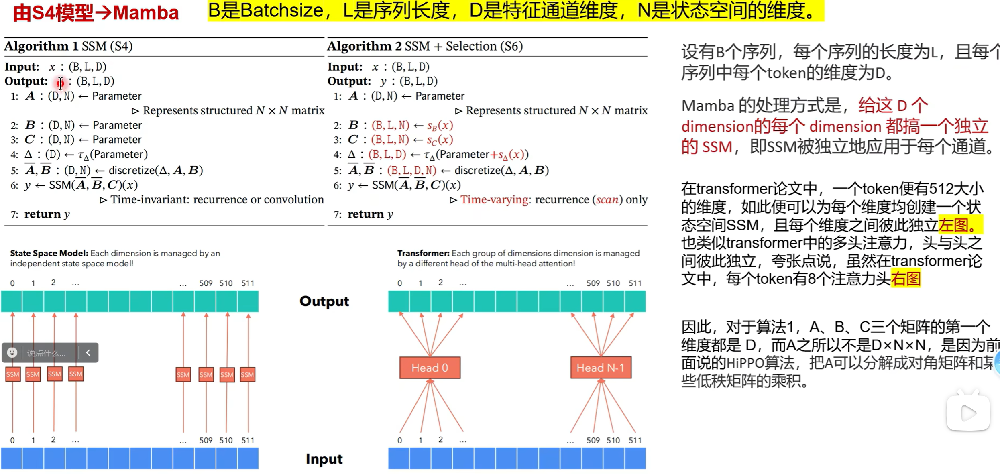

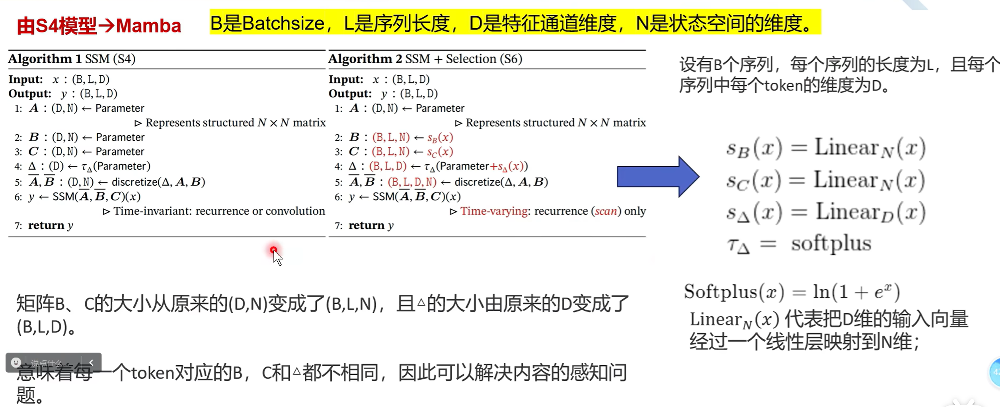

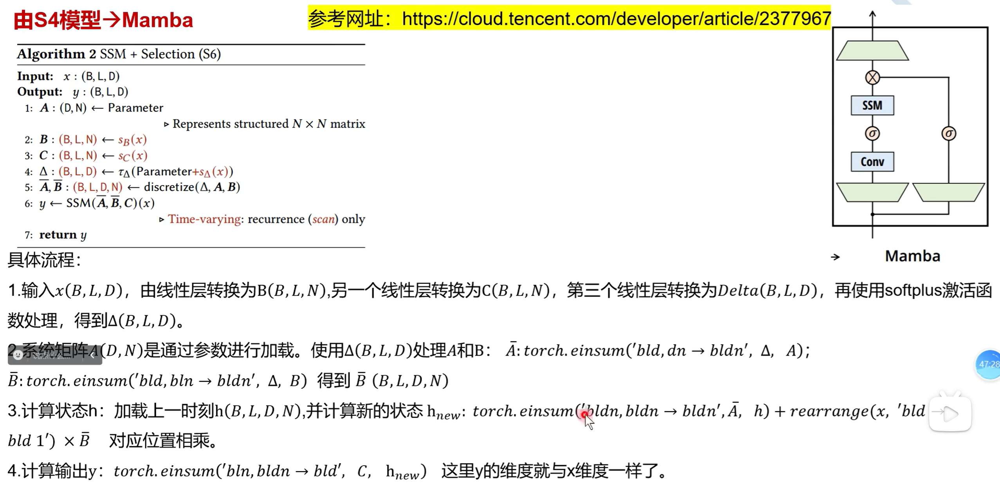

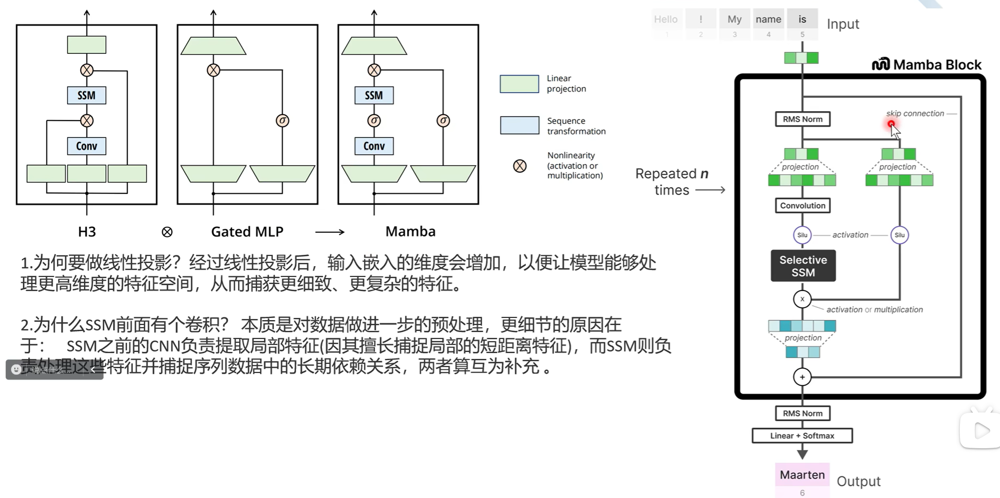

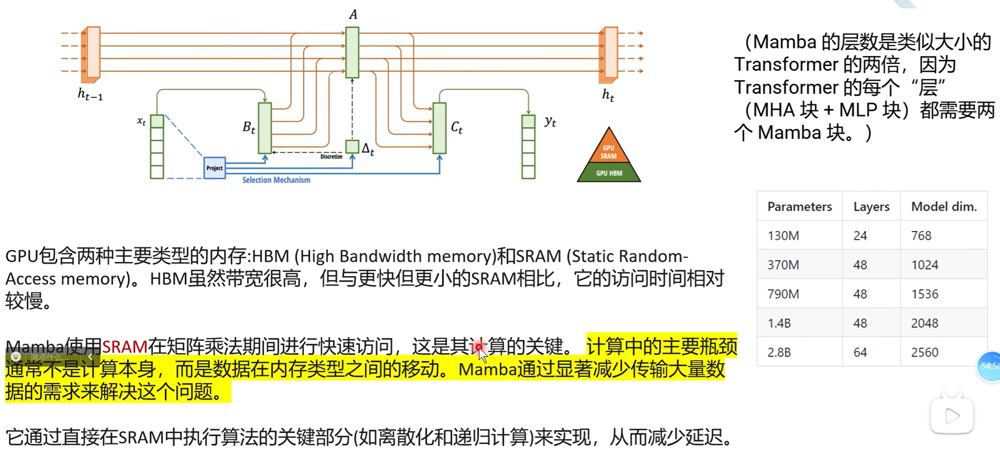

### Vision Mamba

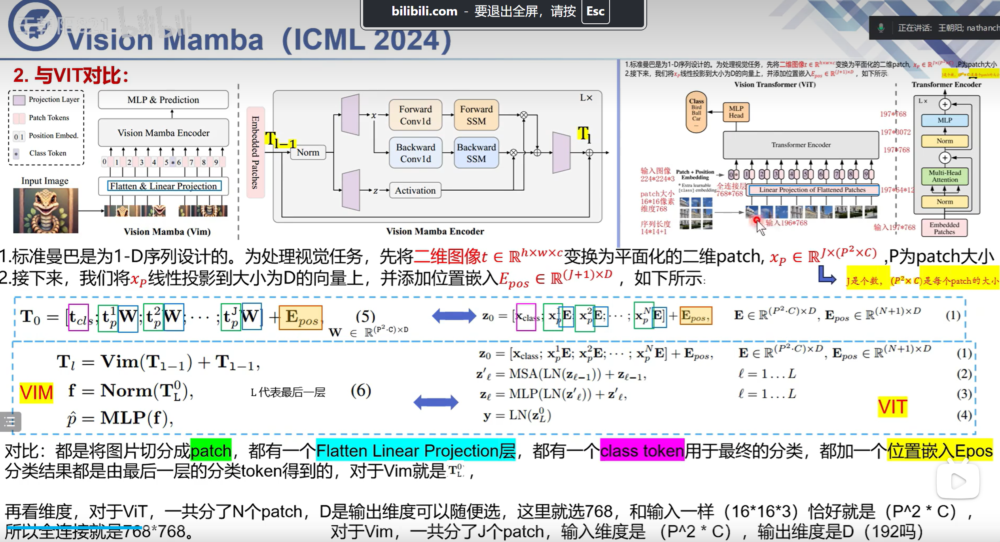



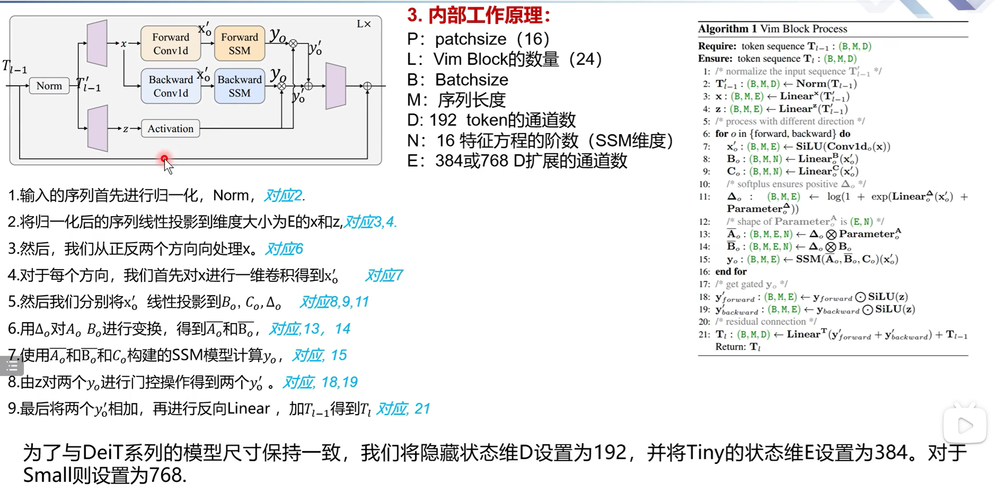

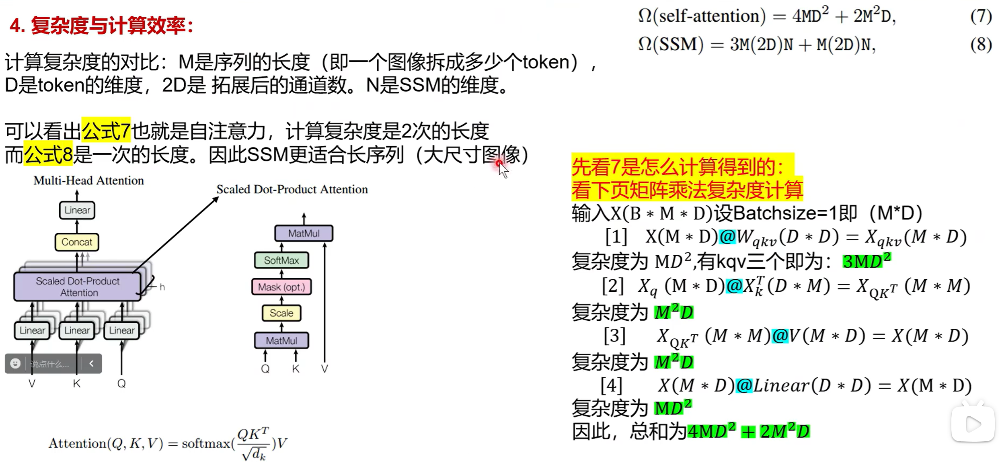

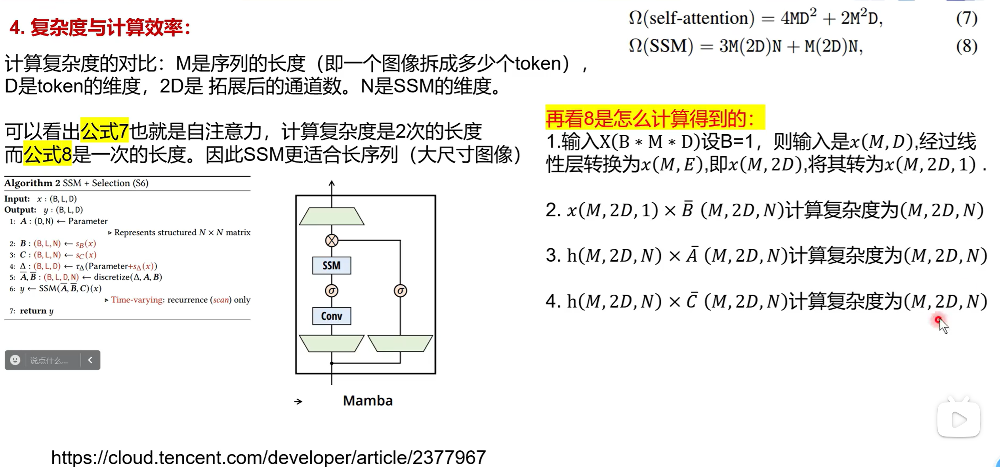


### VMamba



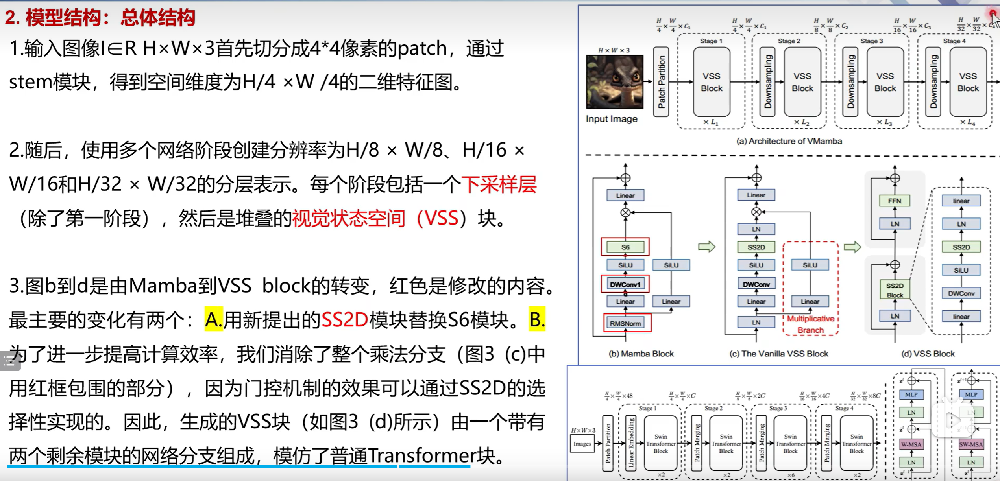

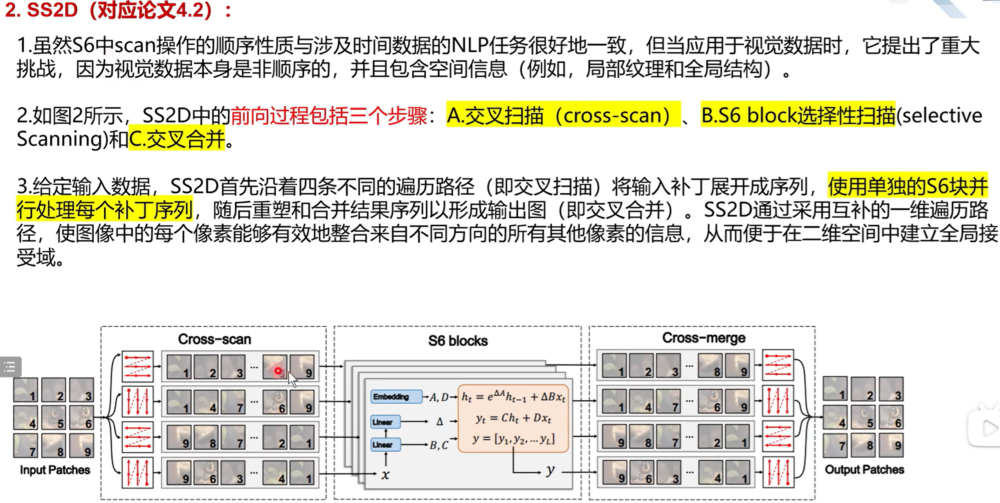

1. 过往三年营业额2000万以上；
2. 注册资金1000万以上；
3. 9001质量体系认证；
4. 挖机研发认可，符合技术参数，研发试用，试用可以后推荐给商务，降成本、提升性能；
5. 商务关系，商务认可；
6. 小批量采购，质保认可；
7. 新供应商董办、外购外协件办公室。 
8. 泵路事业部。

# torch/extension.h 父文件夹
export CPATH=/home/vtchen/miniconda3/envs/vtcuda/torch/lib/python3.13/site-packages/torch/include:$CPATH
# torch/all.h 父文件夹
export CPATH=/home/vtchen/miniconda3/envs/vtcuda/torch/lib/python3.13/site-packages/torch/include/torch/csrc/api/include:$CPATH
# Python.h 父文件夹
export CPATH=/home/vtchen/miniconda3/envs/vtcuda/torch/include/python3.13:$CPATH

## Mamba代码

In [1]:
import sysconfig
print(sysconfig.get_paths()['include'])

/home/vtchen/miniconda3/envs/vtcuda/include/python3.13


In [ ]:
import torch

print(torch.cuda.is_available())

2.8.0+cu126
True
